**1. DESCRIPCION**


Columnas:

CRIM: Per capita crime rate by town

ZN: Proportion of residential land zoned for lots over 25,000 sq. ft

INDUS: Proportion of non-retail business acres per town

CHAS : Charles River dummy variable (1 if tract bounds river; 0 otherwise)

NOX: Nitric oxide concentration (parts per 10 million)

RM: Average number of rooms per dwelling

AGE: Proportion of owner-occupied units built prior to 1940

DIS: Weighted distances to five Boston employment centers

RAD: Index of accessibility to radial highways

PTRATIO: Pupil-teacher ratio by town

B: 1000(Bk — 0.63)², where Bk is the proportion of [people of African American descent] by town

LSTAT: Percentage of lower status of the population

MEDV: Median value of owner-occupied homes in $1000s

In [9]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
plt.rcParams["figure.figsize"] = (10,6)
import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from collections import Counter
from IPython.core.display import display, HTML
sns.set_style('darkgrid')

from sklearn.datasets import load_boston

In [10]:
#df_all = pd.read_csv('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/housing.csv')
boston_dataset = load_boston()
df_all = pd.DataFrame(boston_dataset.data, columns = boston_dataset.feature_names)

#df_train.name = 'Conjunto de entrenamiento'
#df_test.name = 'Conjunto de prueba'
df_all.name = 'Conjunto Total' 

#dfs = [df_train, df_test]
#print(df_test.shape)

print('Numero de ejemplos = {}'.format(df_all.shape[0]))
#print('Entrenamiento X Shape = {}'.format(df_train.shape))
#print('Entrenamiento y Shape = {}\n'.format(df_train['Survived'].shape[0]))
print('X Shape = {}'.format(df_all.shape))
print('y Shape = {}\n'.format(df_all.shape[0]))
print(df_all.columns)

Numero de ejemplos = 506
X Shape = (506, 13)
y Shape = 506

Index(['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD', 'TAX',
       'PTRATIO', 'B', 'LSTAT'],
      dtype='object')


In [11]:
df_all

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


In [12]:
df_all.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33


In [13]:
df_all.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000


In [19]:
df_all['MEDV'] = boston_dataset.target

In [20]:
df_all.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


**2. EDA**

In [21]:
df_all.isnull().sum()

CRIM       0
ZN         0
INDUS      0
CHAS       0
NOX        0
RM         0
AGE        0
DIS        0
RAD        0
TAX        0
PTRATIO    0
B          0
LSTAT      0
MEDV       0
dtype: int64

In [22]:
def check_dist(df, var):
    plt.subplot(1, 2, 1)
    sns.histplot(x=var, data=df, kde = True)
    plt.subplot(1, 2, 2)
    stats.probplot(df[var], dist="norm", plot=plt)
    plt.show()

CRIM


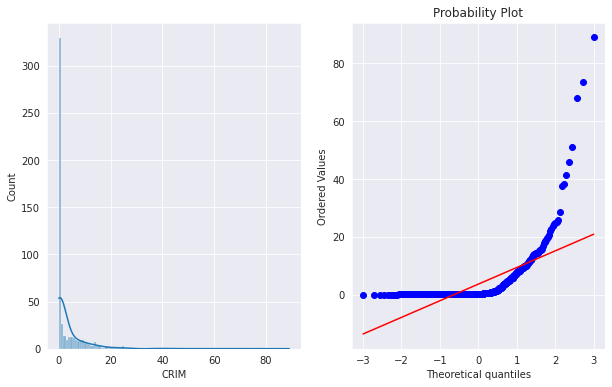

ZN


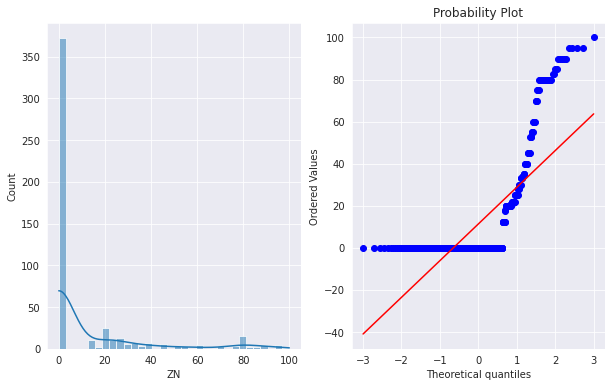

INDUS


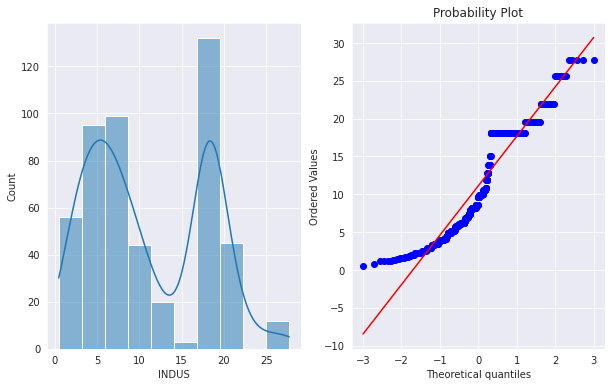

CHAS


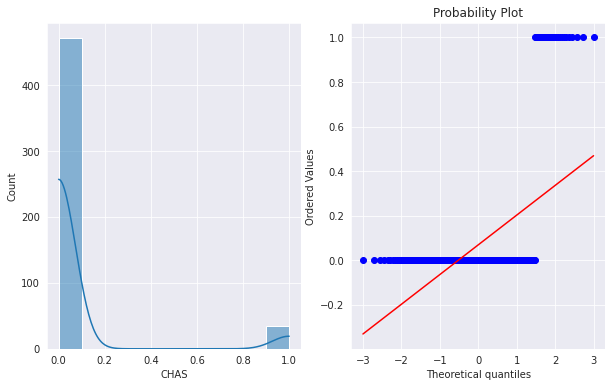

NOX


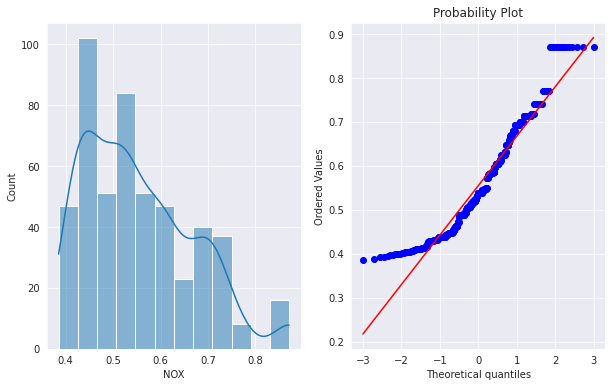

RM


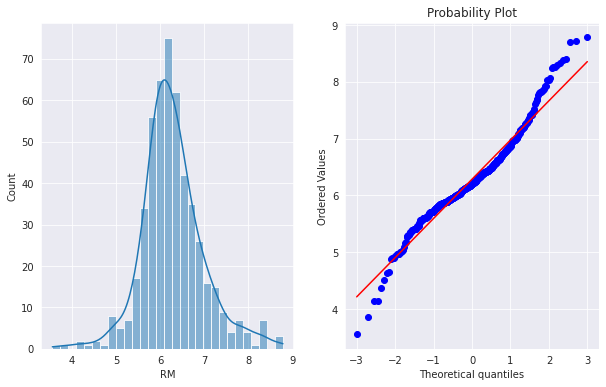

AGE


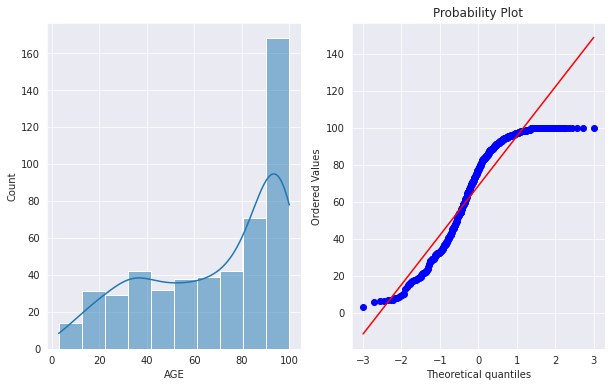

DIS


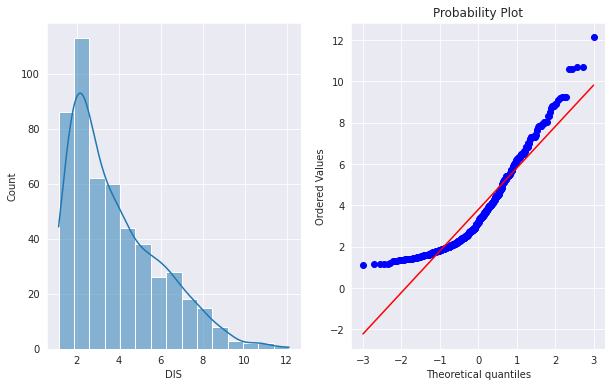

RAD


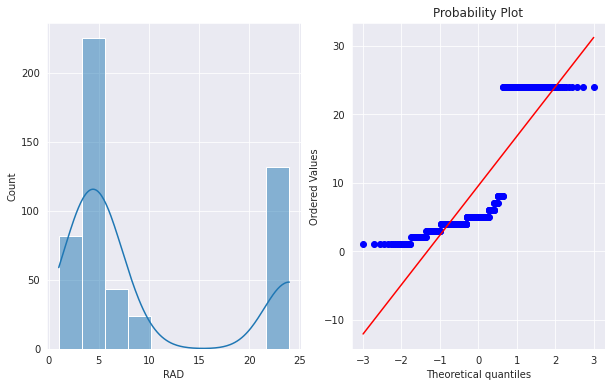

TAX


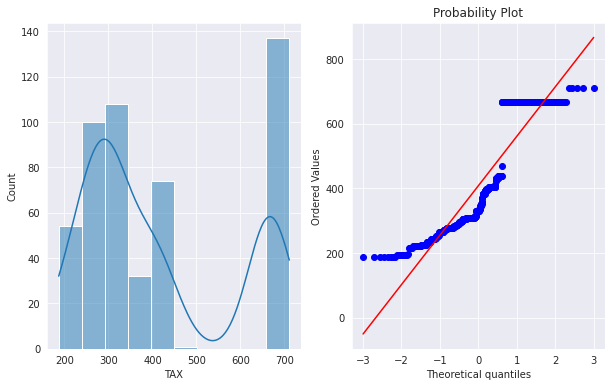

PTRATIO


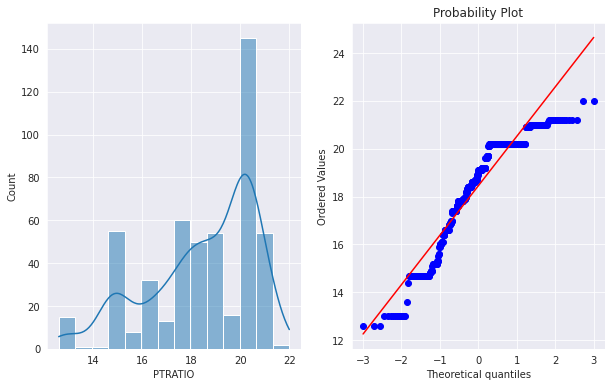

B


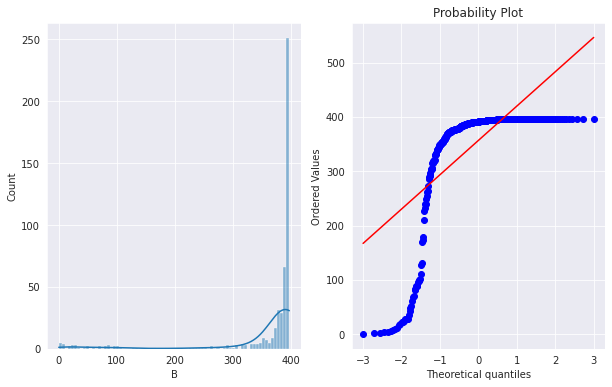

LSTAT


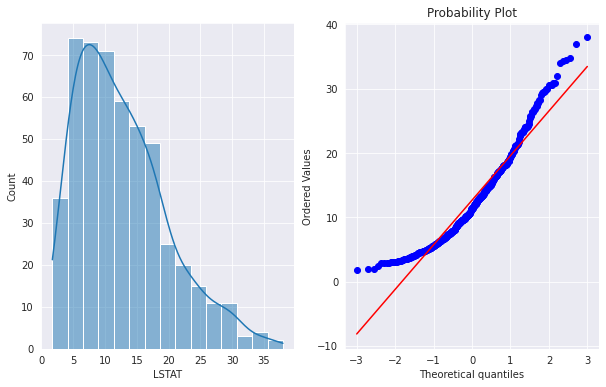

In [23]:
for col in df_all.drop("MEDV", axis =1).columns:
    print(col)
    check_dist(df_all, col)

CRIM


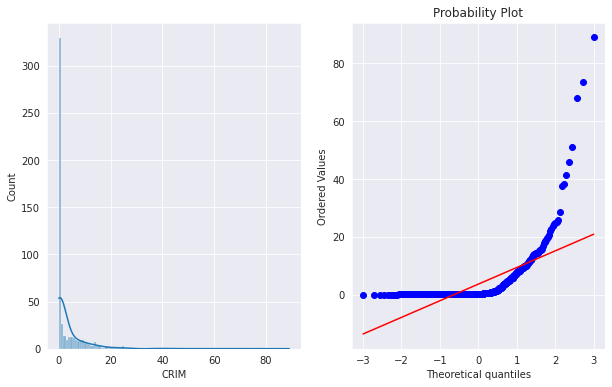

ZN


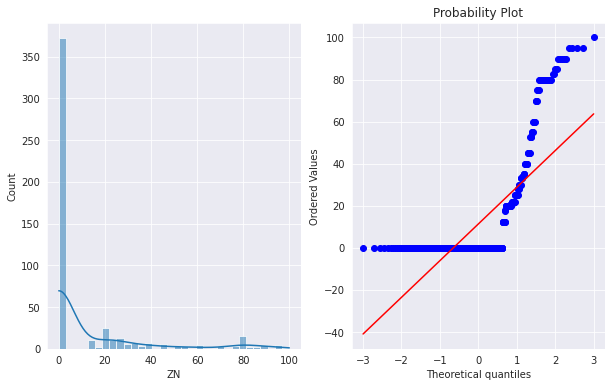

INDUS


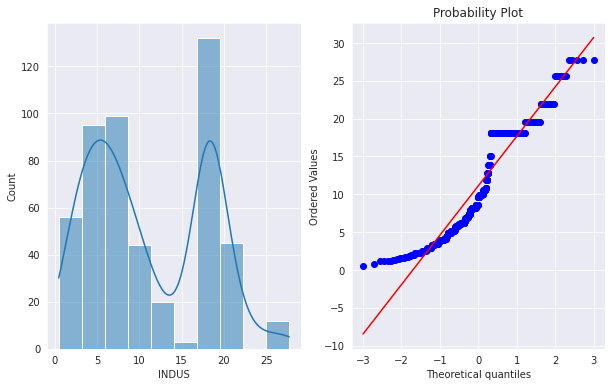

CHAS


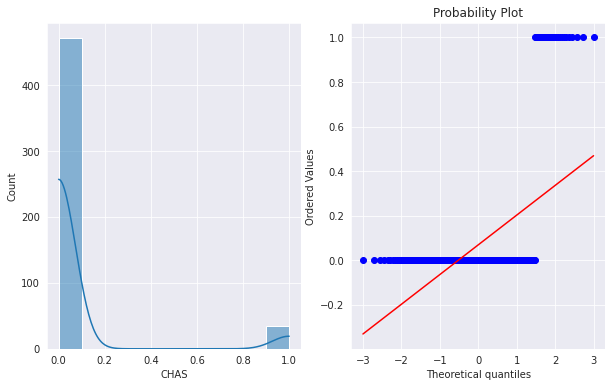

NOX


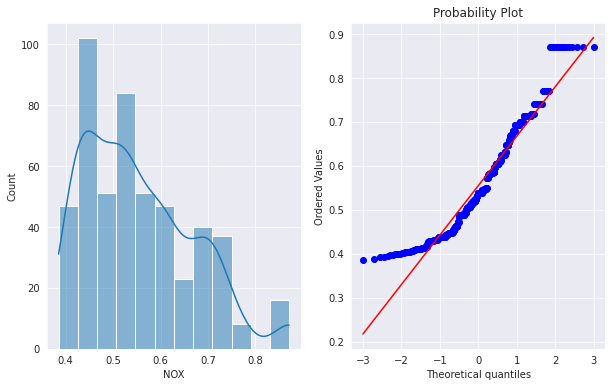

RM


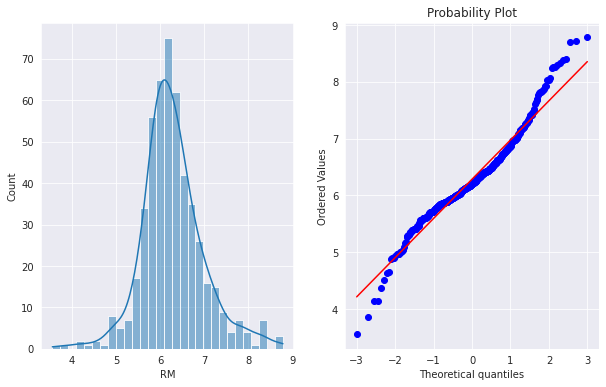

AGE


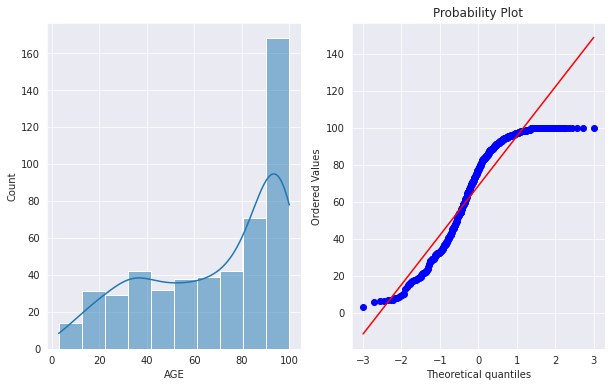

DIS


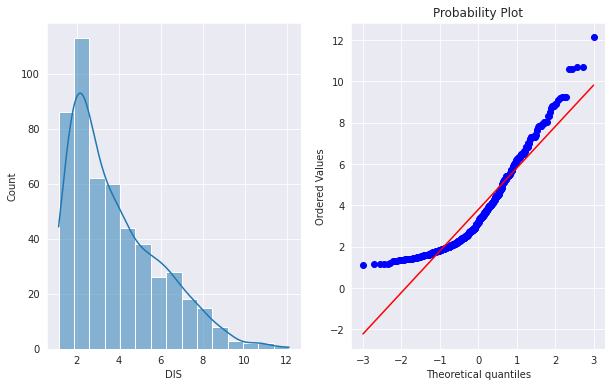

RAD


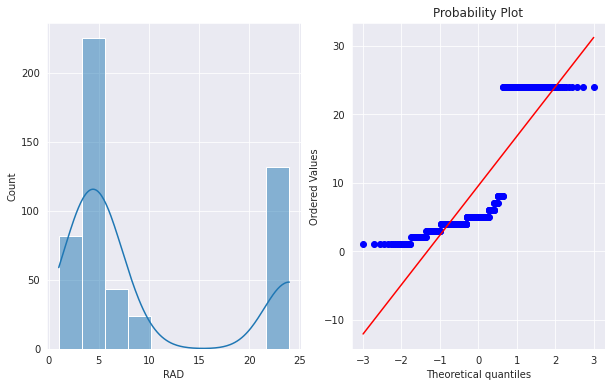

TAX


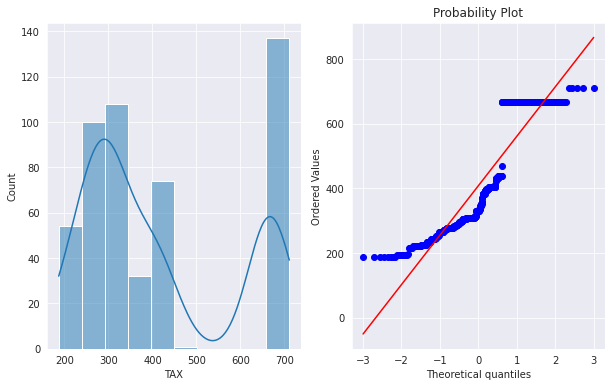

PTRATIO


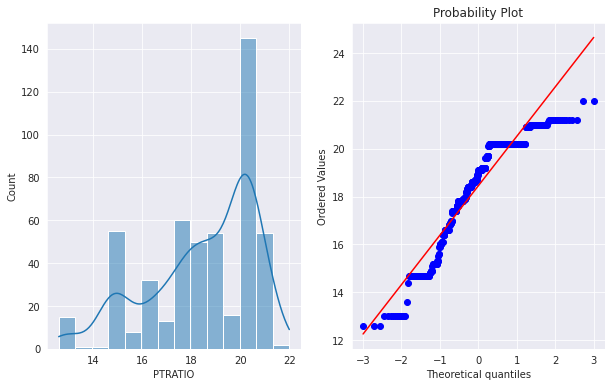

B


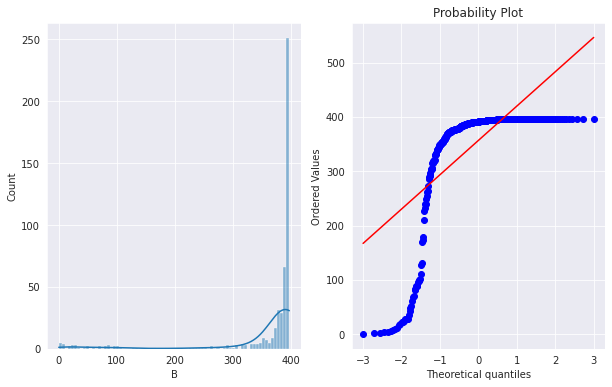

LSTAT


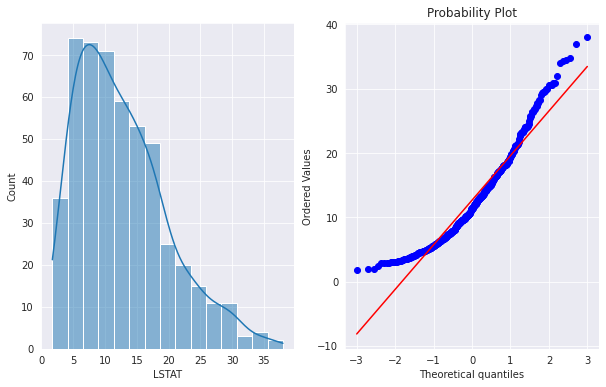

MEDV


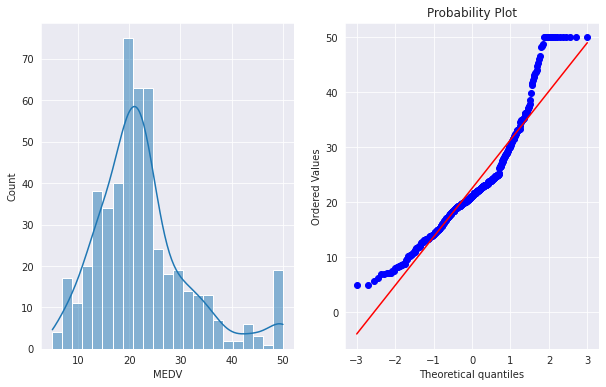

In [24]:
for col in df_all.columns:
    print(col)
    check_dist(df_all, col)

In [25]:
from scipy.stats import skew
for i in df_all.drop(columns="MEDV").columns:
    print(i, skew(df_all[i]))   

CRIM 5.207652387859715
ZN 2.219063057148425
INDUS 0.29414627684418543
CHAS 3.395799292642519
NOX 0.7271441597740319
RM 0.40241466802496245
AGE -0.5971855948016143
DIS 1.0087787565152246
RAD 1.0018334924536951
TAX 0.6679682687237768
PTRATIO -0.7999445320367449
B -2.8817983452627716
LSTAT 0.9037707431346133


In [13]:
##sns.pairplot(df_all);

In [26]:
X = df_all.iloc[:, 0:13].values
y = df_all.iloc[:, 13].values.reshape(-1,1)

**Train -Test Split**

In [27]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split

X = df_all.drop(columns ="MEDV") #df[["RM", "LSTAT", "PTRATIO"]]
y = df_all["MEDV"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 25)

In [28]:
print("Shape of X_train: ",X_train.shape)
print("Shape of X_test: ", X_test.shape)
print("Shape of y_train: ",y_train.shape)
print("Shape of y_test",y_test.shape)

Shape of X_train:  (354, 13)
Shape of X_test:  (152, 13)
Shape of y_train:  (354,)
Shape of y_test (152,)


**Visualizing data**

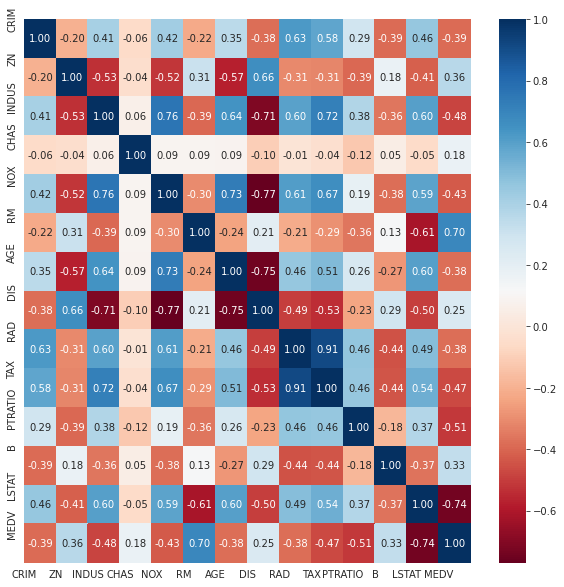

In [29]:
corr = df_all.corr()
#Plot figsize
fig, ax = plt.subplots(figsize=(10, 10))
#Generate Heat Map, allow annotations and place floats in map
sns.heatmap(corr, cmap='RdBu', annot=True, fmt=".2f")
#Apply xticks
plt.xticks(range(len(corr.columns)), corr.columns);
#Apply yticks
plt.yticks(range(len(corr.columns)), corr.columns)
#show plot
plt.show()

In [30]:
X_train

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
260,0.54011,20.0,3.97,0.0,0.647,7.203,81.8,2.1121,5.0,264.0,13.0,392.80,9.59
19,0.72580,0.0,8.14,0.0,0.538,5.727,69.5,3.7965,4.0,307.0,21.0,390.95,11.28
30,1.13081,0.0,8.14,0.0,0.538,5.713,94.1,4.2330,4.0,307.0,21.0,360.17,22.60
102,0.22876,0.0,8.56,0.0,0.520,6.405,85.4,2.7147,5.0,384.0,20.9,70.80,10.63
290,0.03502,80.0,4.95,0.0,0.411,6.861,27.9,5.1167,4.0,245.0,19.2,396.90,3.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,0.24522,0.0,9.90,0.0,0.544,5.782,71.7,4.0317,4.0,304.0,18.4,396.90,15.94
143,4.09740,0.0,19.58,0.0,0.871,5.468,100.0,1.4118,5.0,403.0,14.7,396.90,26.42
474,8.05579,0.0,18.10,0.0,0.584,5.427,95.4,2.4298,24.0,666.0,20.2,352.58,18.14
318,0.40202,0.0,9.90,0.0,0.544,6.382,67.2,3.5325,4.0,304.0,18.4,395.21,10.36


In [31]:
X_test

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
125,0.16902,0.0,25.65,0.0,0.581,5.986,88.4,1.9929,2.0,188.0,19.1,385.02,14.81
486,5.69175,0.0,18.10,0.0,0.583,6.114,79.8,3.5459,24.0,666.0,20.2,392.68,14.98
324,0.34109,0.0,7.38,0.0,0.493,6.415,40.1,4.7211,5.0,287.0,19.6,396.90,6.12
386,24.39380,0.0,18.10,0.0,0.700,4.652,100.0,1.4672,24.0,666.0,20.2,396.90,28.28
459,6.80117,0.0,18.10,0.0,0.713,6.081,84.4,2.7175,24.0,666.0,20.2,396.90,14.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,0.05059,0.0,4.49,0.0,0.449,6.389,48.0,4.7794,3.0,247.0,18.5,396.90,9.62
307,0.04932,33.0,2.18,0.0,0.472,6.849,70.3,3.1827,7.0,222.0,18.4,396.90,7.53
173,0.09178,0.0,4.05,0.0,0.510,6.416,84.1,2.6463,5.0,296.0,16.6,395.50,9.04
56,0.02055,85.0,0.74,0.0,0.410,6.383,35.7,9.1876,2.0,313.0,17.3,396.90,5.77


In [32]:
y_train

260    33.8
19     18.2
30     12.7
102    18.6
290    28.5
       ... 
317    19.8
143    15.6
474    13.8
318    23.1
132    23.0
Name: MEDV, Length: 354, dtype: float64

In [33]:
y_test

125    21.4
486    19.1
324    25.0
386    10.5
459    20.0
       ... 
84     23.9
307    28.2
173    23.6
56     24.7
431    14.1
Name: MEDV, Length: 152, dtype: float64

**3. MODELOS DE REGRESION**

**Linear Regression**

In [34]:
from sklearn.linear_model import LinearRegression

#Comentar las dos lineas siguientes, solo para visualizar
#X_train_visualize = df_all.iloc[:354, 12:13].values               #PTRATIO
#X_train_visualize = df_all.iloc[:354, 10:11].values               #PTRATIO
#X_train_visualize = df_all.iloc[:354, 4:5].values               #NOX
X_train_visualize = df_all.iloc[:354, 5:6].values                #Numero de habitaciones RM
y_train_visualize = df_all.iloc[:354, 13].values.reshape(-1,1)
regressor_linear_visualize = LinearRegression()
regressor_linear_visualize.fit(X_train_visualize, y_train_visualize)

#Aqui si tomamos todos los features o caracteristicas
regressor_linear = LinearRegression()
regressor_linear.fit(X_train, y_train)

LinearRegression()

In [35]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score the Test set results
cv_linear = cross_val_score(estimator = regressor_linear, X = X_train, y = y_train, cv = 10)

# Predicting R2 Score the Train set results
y_pred_linear_train = regressor_linear.predict(X_train)
y_pred_linear_train_visualize = regressor_linear_visualize.predict(X_train_visualize)
r2_score_linear_train = r2_score(y_train, y_pred_linear_train)

# Predicting R2 Score the Test set results
y_pred_linear_test = regressor_linear.predict(X_test)
r2_score_linear_test = r2_score(y_test, y_pred_linear_test)



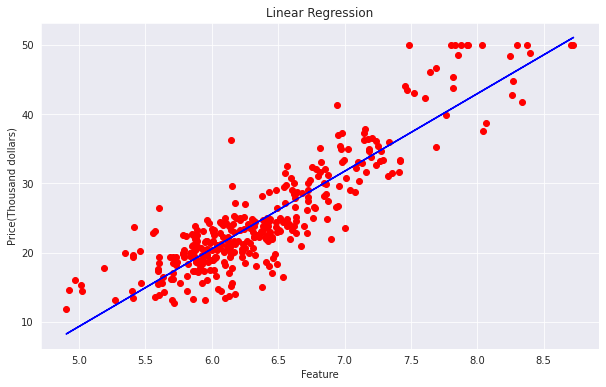

In [36]:
# Visualising the Linear Regression results

#print(X_train_visualize.shape)
#print(y_train_visualize.shape)
#print(y_pred_linear_train.shape)

plt.scatter(X_train_visualize, y_train_visualize, color = 'red')
plt.plot(X_train_visualize, y_pred_linear_train_visualize, color = 'blue')
plt.title('Linear Regression')
plt.xlabel('Feature')
plt.ylabel('Price(Thousand dollars)')
plt.show()

In [37]:
# Visualising the Polynomial Regression results (for higher resolution and smoother curve)
#X_grid = np.arange(min(X_train), max(X_train), 0.1)
#X_grid = X_grid.reshape((len(X_grid), 1))
#plt.scatter(X_train, y_train, color = 'red')
#plt.plot(X_grid, lin_reg_2.predict(poly_reg.fit_transform(X_grid)), color = 'blue')
#plt.title('Truth or Bluff (Polynomial Regression)')
#plt.xlabel('Position level')
#plt.ylabel('Salary')
#plt.show()

In [38]:
y_pred_linear_test

array([23.21241482, 19.49239614, 25.13492123,  6.27095164, 18.18546048,
       25.60609238, 34.52388805, 12.44823876, 14.0410865 , 34.12643474,
       14.06421194, 13.84606345, 18.89012035, 19.6680125 , 36.0005335 ,
       23.25833154, 28.7347754 ,  3.80208844,  7.95302512, 24.28614224,
       23.19699393, 14.17694607, 29.93120546, 27.35078486, 23.51427714,
       23.20116244, 38.99665047, 23.25398324, 23.88330235, 23.27494551,
       30.9030135 , 31.77951258, 17.45611666, 13.05143724, 14.31912141,
       20.77317934, 17.83789405, 27.45300029, 25.15841147, 21.22103347,
       18.20542918, 21.88503901, 17.24811501, 17.94900737, 14.66633568,
       25.42353621, 23.61709092, 28.55882903, 30.33793405, 10.45475045,
       18.41824246, 19.45357799, 34.08656247, 19.00724682, 20.15875158,
       15.34753291, 34.56445666, 27.69170436, 14.53163307, 32.34764928,
       22.77550964, 20.4135404 , 27.38049702, 20.46310816, 24.71590042,
       14.1305901 , 22.7428744 , 29.95564979, 26.15740268, 15.09

In [39]:
my_dict = {"Actual": y_test, "Pred": y_pred_linear_test, "Residual":y_test - y_pred_linear_test}

In [40]:
comparing = pd.DataFrame(my_dict)
comparing

,Actual,Pred,Residual
125,21.4,23.212415,-1.812415
486,19.1,19.492396,-0.392396
324,25.0,25.134921,-0.134921
386,10.5,6.270952,4.229048
459,20.0,18.185460,1.814540
...,...,...,...
84,23.9,25.100352,-1.200352
307,28.2,33.434188,-5.234188
173,23.6,29.213348,-5.613348
56,24.7,24.720948,-0.020948


In [41]:
result_sample = comparing.head(25)
result_sample

,Actual,Pred,Residual
125,21.4,23.212415,-1.812415
486,19.1,19.492396,-0.392396
324,25.0,25.134921,-0.134921
386,10.5,6.270952,4.229048
459,20.0,18.185460,1.814540
213,28.1,25.606092,2.493908
274,32.4,34.523888,-2.123888
491,13.6,12.448239,1.151761
429,9.5,14.041087,-4.541087
273,35.2,34.126435,1.073565


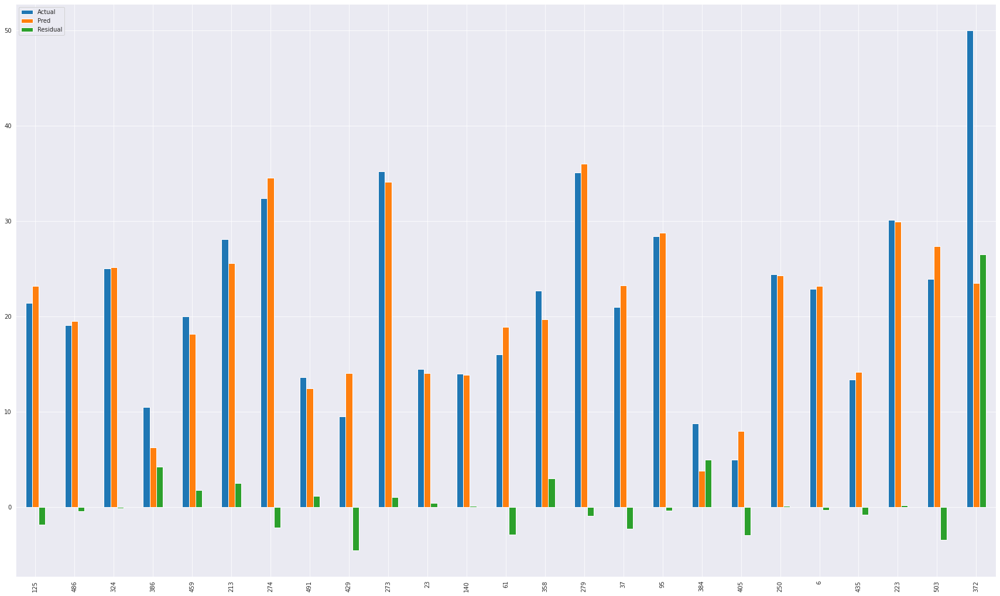

In [43]:
result_sample.plot(kind ="bar", figsize=(30,18))
plt.show()

In [44]:
# Predicting RMSE the Test set results
def eval_metric(y_test, y_pred_linear_test):
  mse = mean_squared_error(y_test, y_pred_linear_test)
  rmse_linear = (np.sqrt(mean_squared_error(y_test, y_pred_linear_test)))
  mae = mean_absolute_error(y_test, y_pred_linear_test)

  print("CV: ", cv_linear.mean())
  print('R2_score (train): ', r2_score_linear_train)
  print('R2_score (test): ', r2_score_linear_test)
  print("MSE: ", mse)
  print("RMSE: ", rmse_linear)
  print("MAE: ", mae)

In [45]:
eval_metric(y_test, y_pred_linear_test)
rmse_linear = (np.sqrt(mean_squared_error(y_test, y_pred_linear_test)))

CV:  0.6984854476156037
R2_score (train):  0.7435787589010061
R2_score (test):  0.7133593313710342
MSE:  21.59720903501856
RMSE:  4.647279745724219
MAE:  3.1175694194800916


In [46]:
eval_metric(y_train, y_pred_linear_train)

CV:  0.6984854476156037
R2_score (train):  0.7435787589010061
R2_score (test):  0.7133593313710342
MSE:  22.64350774919138
RMSE:  4.758519491311492
MAE:  3.3670963135177105


**Residuos**

En la práctica el modelo de regresión nunca predecira exactamente la variable dependiente, siempre habra un error. Este mismo error debe tener una variación constante sobre el rango predicho.

Para probar la **homocedasticidad**, es decir, la varianza constante de los residuos, la variable dependiente se representa en el eje x y el error en el eje y. Ahora el error debería dispersarse uniformemente en todo el rango. Si este es el caso, la homocedasticidad está presente. Si este no es el caso, la heteroscedasticidad está presente. En el caso de la heterocedasticidad, el error tiene diferentes varianzas, dependiendo del rango de valores de la variable dependiente.

In [34]:
residuals = y_test-y_pred_linear_test

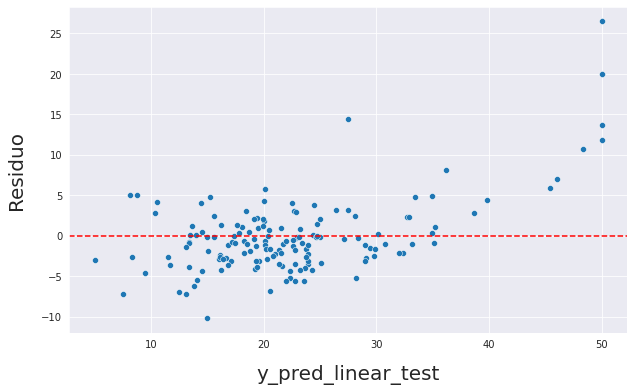

In [35]:
plt.figure(figsize = (10,6))
sns.scatterplot(x = y_test, y = residuals) #-residuals
plt.xlabel('y_pred_linear_test', size=20, labelpad=15)
plt.ylabel('Residuo', size=20, labelpad=15)
plt.axhline(y = 0, color ="r", linestyle = "--")
plt.show()

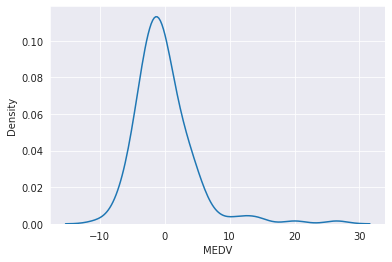

In [36]:
sns.kdeplot(residuals);

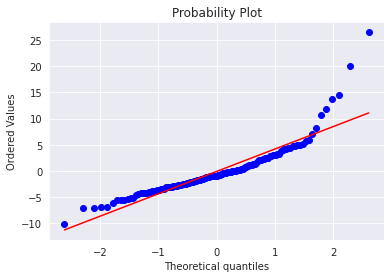

In [37]:
stats.probplot(residuals, dist ="norm", plot =plt);

In [38]:
skew(residuals)

2.2048486910904934

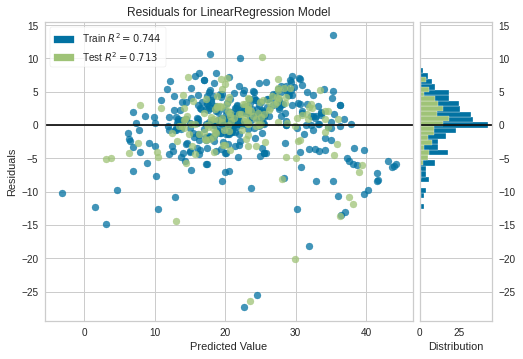

In [39]:
from yellowbrick.regressor import ResidualsPlot

# Instanciar el modelo lineal y el visualizador
model = LinearRegression()
visualizer = ResidualsPlot(model)

visualizer.fit(X_train, y_train)  # Ajustar la data de entrenamiento al visualizador
visualizer.score(X_test, y_test)  # Evaluar el modelo en la data de prueba
visualizer.show();        # Finalizar el renderizado de la figura

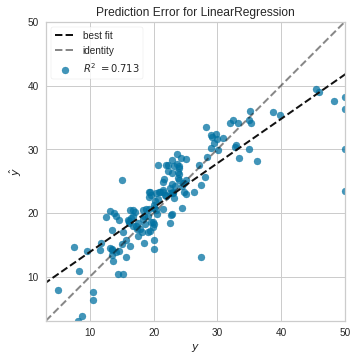

In [40]:
from yellowbrick.regressor import PredictionError
# Instanciar el modelo lineal y el visualizador
model = LinearRegression()
visualizer = PredictionError(model)

visualizer.fit(X_train, y_train)  # Ajustar la data de entrenamiento al visualizador
visualizer.score(X_test, y_test)  # Evaluar el modelo en la data de prueba
visualizer.show();

**Polynomial Regression - 2nd degree**

In [47]:
import numpy as np
from sklearn.preprocessing import PolynomialFeatures
poly_reg = PolynomialFeatures(degree = 2)
X_poly = poly_reg.fit_transform(X_train)
poly_reg.fit(X_poly, y_train)
regressor_poly2 = LinearRegression()
regressor_poly2.fit(X_poly, y_train)

LinearRegression()

In [48]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score the Test set results
cv_poly2 = cross_val_score(estimator = regressor_poly2, X = X_train, y = y_train, cv = 10)

# Predicting R2 Score the Train set results
y_pred_poly2_train = regressor_poly2.predict(poly_reg.fit_transform(X_train))
r2_score_poly2_train = r2_score(y_train, y_pred_poly2_train)

# Predicting R2 Score the Test set results
y_pred_poly2_test = regressor_poly2.predict(poly_reg.fit_transform(X_test))
r2_score_poly2_test = r2_score(y_test, y_pred_poly2_test)

# Predicting RMSE the Test set results
rmse_poly2 = (np.sqrt(mean_squared_error(y_test, y_pred_poly2_test)))
print('CV: ', cv_poly2.mean())
print('R2_score (train): ', r2_score_poly2_train)
print('R2_score (test): ', r2_score_poly2_test)
print("RMSE: ", rmse_poly2)

CV:  0.6984854476156037
R2_score (train):  0.9306558489083436
R2_score (test):  0.7665134369454242
RMSE:  4.194313207139797


In [49]:
'''#Plot regresión predice líneas rectas
degree = 2
# Visualising the Linear Regression results
#plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_train, regressor_linear.predict(X_train), color = 'blue')
plt.title('Truth or Bluff (Linear Regression)')
plt.xlabel('Position level')
plt.ylabel('Salary')
plt.show()

# Visualising the Polynomial Regression results
#plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_train, regressor_poly2.predict(poly_reg.fit_transform(X_train)), color = 'blue')
plt.title('Truth or Bluff (Polynomial Regression)')
plt.xlabel('Position level')
plt.ylabel('Salary')
plt.show()'''

"#Plot regresión predice líneas rectas\ndegree = 2\n# Visualising the Linear Regression results\n#plt.scatter(X_train, y_train, color = 'red')\nplt.plot(X_train, regressor_linear.predict(X_train), color = 'blue')\nplt.title('Truth or Bluff (Linear Regression)')\nplt.xlabel('Position level')\nplt.ylabel('Salary')\nplt.show()\n\n# Visualising the Polynomial Regression results\n#plt.scatter(X_train, y_train, color = 'red')\nplt.plot(X_train, regressor_poly2.predict(poly_reg.fit_transform(X_train)), color = 'blue')\nplt.title('Truth or Bluff (Polynomial Regression)')\nplt.xlabel('Position level')\nplt.ylabel('Salary')\nplt.show()"

**Ridge (Spinal) Regression**

In [50]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures

steps = [
    ('scalar', StandardScaler()),
    ('poly', PolynomialFeatures(degree=2)),
    ('model', Ridge(alpha=3.8, fit_intercept=True))
]

ridge_pipe = Pipeline(steps)
ridge_pipe.fit(X_train, y_train)

Pipeline(steps=[('scalar', StandardScaler()), ('poly', PolynomialFeatures()),
                ('model', Ridge(alpha=3.8))])

In [52]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score the Test set results
cv_ridge = cross_val_score(estimator = ridge_pipe, X = X_train, y = y_train.ravel(), cv = 10)

# Predicting R2 Score the Test set results
y_pred_ridge_train = ridge_pipe.predict(X_train)
r2_score_ridge_train = r2_score(y_train, y_pred_ridge_train)

# Predicting R2 Score the Test set results
y_pred_ridge_test = ridge_pipe.predict(X_test)
r2_score_ridge_test = r2_score(y_test, y_pred_ridge_test)

# Predicting RMSE the Test set results
rmse_ridge = (np.sqrt(mean_squared_error(y_test, y_pred_ridge_test)))
print('CV: ', cv_ridge.mean())
print('R2_score (train): ', r2_score_ridge_train)
print('R2_score (test): ', r2_score_ridge_test)
print("RMSE: ", rmse_ridge)

CV:  0.7635629962138724
R2_score (train):  0.9228176586388411
R2_score (test):  0.8919654552985881
RMSE:  2.853062166443769


**Lasso Regression**

In [53]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures

steps = [
    ('scalar', StandardScaler()),
    ('poly', PolynomialFeatures(degree=2)),
    ('model', Lasso(alpha=0.012, fit_intercept=True, max_iter=3000))
]

lasso_pipe = Pipeline(steps)
lasso_pipe.fit(X_train, y_train)

Pipeline(steps=[('scalar', StandardScaler()), ('poly', PolynomialFeatures()),
                ('model', Lasso(alpha=0.012, max_iter=3000))])

In [56]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score
cv_lasso = cross_val_score(estimator = lasso_pipe, X = X_train, y = y_train, cv = 10)

# Predicting R2 Score the Test set results
y_pred_lasso_train = lasso_pipe.predict(X_train)
r2_score_lasso_train = r2_score(y_train, y_pred_lasso_train)

# Predicting R2 Score the Test set results
y_pred_lasso_test = lasso_pipe.predict(X_test)
r2_score_lasso_test = r2_score(y_test, y_pred_lasso_test)

# Predicting RMSE the Test set results
rmse_lasso = (np.sqrt(mean_squared_error(y_test, y_pred_lasso_test)))
print('CV: ', cv_lasso.mean())
print('R2_score (train): ', r2_score_lasso_train)
print('R2_score (test): ', r2_score_lasso_test)
print("RMSE: ", rmse_lasso)

CV:  0.7505443182491585
R2_score (train):  0.9234017201921203
R2_score (test):  0.895093807552504
RMSE:  2.8114507112289


**Support Vector Regression**

In [57]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
sc_y = StandardScaler()
#print(y_train.values.reshape(-1,1))
X_scaled = sc_X.fit_transform(X_train)
y_scaled = sc_y.fit_transform(y_train.values.reshape(-1,1))

In [58]:
# Fitting the SVR Model to the dataset
from sklearn.svm import SVR
regressor_svr = SVR(kernel = 'rbf', gamma = 'scale')
regressor_svr.fit(X_scaled, y_scaled.ravel())

SVR()

In [59]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score
cv_svr = cross_val_score(estimator = regressor_svr, X = X_scaled, y = y_scaled.ravel(), cv = 10)
print(regressor_svr.predict(sc_X.transform(X_train)).reshape(-1,1).shape) #Antes de pasarlo a inverse_transform debe ser 2D
# Predicting R2 Score the Train set results
y_pred_svr_train = sc_y.inverse_transform(regressor_svr.predict(sc_X.transform(X_train)).reshape(-1,1))
r2_score_svr_train = r2_score(y_train, y_pred_svr_train)

# Predicting R2 Score the Test set results
y_pred_svr_test = sc_y.inverse_transform(regressor_svr.predict(sc_X.transform(X_test)).reshape(-1,1))
r2_score_svr_test = r2_score(y_test, y_pred_svr_test)

# Predicting RMSE the Test set results
rmse_svr = (np.sqrt(mean_squared_error(y_test, y_pred_svr_test)))
print('CV: ', cv_svr.mean())
print('R2_score (train): ', r2_score_svr_train)
print('R2_score (test): ', r2_score_svr_test)
print("RMSE: ", rmse_svr)

(354, 1)
CV:  0.7826006932475841
R2_score (train):  0.8742715669147497
R2_score (test):  0.8044070157723573
RMSE:  3.838897780932836


**Decision Tree Regression**

In [60]:
# Fitting the Decision Tree Regression Model to the dataset
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree
from sklearn.tree import export_graphviz

regressor_dt = DecisionTreeRegressor(random_state = 0)#max_depth = 5
regressor_dt.fit(X_train, y_train)
#regressor_dt.fit(X_train['RM'].values.reshape(-1, 1), y_train)


DecisionTreeRegressor(random_state=0)

In [61]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score
cv_dt = cross_val_score(estimator = regressor_dt, X = X_train, y = y_train, cv = 10)

# Predicting R2 Score the Train set results
#y_pred_dt_train = regressor_dt.predict(X_train['RM'].values.reshape(-1, 1))
y_pred_dt_train = regressor_dt.predict(X_train)
r2_score_dt_train = r2_score(y_train, y_pred_dt_train)

# Predicting R2 Score the Test set results
#y_pred_dt_test = regressor_dt.predict(X_test['RM'].values.reshape(-1, 1))
y_pred_dt_test = regressor_dt.predict(X_test)
r2_score_dt_test = r2_score(y_test, y_pred_dt_test)

#Solo para visualizar
'''X_grid = np.arange(min(X_test['RM']), max(X_test['RM']), 0.1)
X_grid = X_grid.reshape(len(X_grid), 1)
plt.scatter(X_test['RM'], y_test)
plt.plot(X_grid, regressor_dt.predict(X_grid), color='red', linewidth=3)
plt.show()'''

# Predicting RMSE the Test set results
rmse_dt = (np.sqrt(mean_squared_error(y_test, y_pred_dt_test)))
print('CV: ', cv_dt.mean())
print('R2_score (train): ', r2_score_dt_train)
print('R2_score (test): ', r2_score_dt_test)
print("RMSE: ", rmse_dt)

CV:  0.6177422304890111
R2_score (train):  1.0
R2_score (test):  0.5989917396644069
RMSE:  5.496757417356451


In [62]:
# Estructura del árbol creado
# ------------------------------------------------------------------------------
'''fig, ax = plt.subplots(figsize=(12, 5))

print(f"Profundidad del árbol: {regressor_dt.get_depth()}")
print(f"Número de nodos terminales: {regressor_dt.get_n_leaves()}")

plot = plot_tree(
            decision_tree = regressor_dt,
            feature_names = df_all.drop(columns = "MEDV").columns,
            class_names   = 'MEDV',
            filled        = True,
            impurity      = False,
            fontsize      = 10,
            precision     = 2,
            ax            = ax
       )'''

'fig, ax = plt.subplots(figsize=(12, 5))\n\nprint(f"Profundidad del árbol: {regressor_dt.get_depth()}")\nprint(f"Número de nodos terminales: {regressor_dt.get_n_leaves()}")\n\nplot = plot_tree(\n            decision_tree = regressor_dt,\n            feature_names = df_all.drop(columns = "MEDV").columns,\n            class_names   = \'MEDV\',\n            filled        = True,\n            impurity      = False,\n            fontsize      = 10,\n            precision     = 2,\n            ax            = ax\n       )'

**Random Forest Regression** 

In [64]:
# Fitting the Random Forest Regression to the dataset
from sklearn.ensemble import RandomForestRegressor
def create_design_matrix(x_array):
    return x_array.reshape((x_array.shape[0],1))
    
regressor_rf = RandomForestRegressor(n_estimators = 500, random_state = 0)
regressor_rf.fit(X_train, y_train.ravel())
#regressor_rf.fit(create_design_matrix(X_train['RM'].values.reshape(-1, 1)), y_train.ravel())

RandomForestRegressor(n_estimators=500, random_state=0)

In [65]:
from sklearn.metrics import r2_score

# Predicting Cross Validation Score
cv_rf = cross_val_score(estimator = regressor_rf, X = X_scaled, y = y_train.ravel(), cv = 10)

# Predicting R2 Score the Train set results
y_pred_rf_train = regressor_rf.predict(X_train)
#y_pred_rf_train = regressor_rf.predict(create_design_matrix(X_train['RM'].values.reshape(-1, 1)))
r2_score_rf_train = r2_score(y_train, y_pred_rf_train)

'''train_x = np.linspace(3.8, 8.8, num=354)
train_y = y_pred_rf_train

plt.figure(figsize=(20,10)) 
plt.plot(X_train['RM'].values.reshape(-1, 1), y_train.ravel(), 'ro', linewidth=5.0)
plt.plot(train_x, train_y)
plt.show()'''

# Predicting R2 Score the Test set results
y_pred_rf_test = regressor_rf.predict(X_test)
#y_pred_rf_test = regressor_rf.predict(create_design_matrix(X_test['RM'].values.reshape(-1, 1)))
r2_score_rf_test = r2_score(y_test, y_pred_rf_test)

'''test_x = np.linspace(3.7, 8.2, num=152)
test_y = y_pred_rf_test

plt.figure(figsize=(20,10)) 
plt.plot(X_test['RM'].values.reshape(-1, 1), y_test.ravel(), 'ro', linewidth=5.0)
plt.plot(test_x, test_y)
plt.show()'''

# Predicting RMSE the Test set results
rmse_rf = (np.sqrt(mean_squared_error(y_test, y_pred_rf_test)))
print('CV: ', cv_rf.mean())
print('R2_score (train): ', r2_score_rf_train)
print('R2_score (test): ', r2_score_rf_test)
print("RMSE: ", rmse_rf)

CV:  0.8182118617652808
R2_score (train):  0.9768407108850092
R2_score (test):  0.8637486208767902
RMSE:  3.204057971213175


**4. MIDIENDO EL ERROR**

In [66]:
models = [('Linear Regression', rmse_linear, r2_score_linear_train, r2_score_linear_test, cv_linear.mean()),
          ('Polynomial Regression (2nd)', rmse_poly2, r2_score_poly2_train, r2_score_poly2_test, cv_poly2.mean()),
          ('Ridge Regression', rmse_ridge, r2_score_ridge_train, r2_score_ridge_test, cv_ridge.mean()),
          ('Lasso Regression', rmse_lasso, r2_score_lasso_train, r2_score_lasso_test, cv_lasso.mean()),
          ('Support Vector Regression', rmse_svr, r2_score_svr_train, r2_score_svr_test, cv_svr.mean()),
          ('Decision Tree Regression', rmse_dt, r2_score_dt_train, r2_score_dt_test, cv_dt.mean()),
          ('Random Forest Regression', rmse_rf, r2_score_rf_train, r2_score_rf_test, cv_rf.mean())   
         ]

In [67]:
predict = pd.DataFrame(data = models, columns=['Model', 'RMSE', 'R2_Score(training)', 'R2_Score(test)', 'Cross-Validation'])
predict

,Model,RMSE,R2_Score(training),R2_Score(test),Cross-Validation
0,Linear Regression,4.647280,0.743579,0.713359,0.698485
1,Polynomial Regression (2nd),4.194313,0.930656,0.766513,0.698485
2,Ridge Regression,2.853062,0.922818,0.891965,0.763563
3,Lasso Regression,2.811451,0.923402,0.895094,0.750544
4,Support Vector Regression,3.838898,0.874272,0.804407,0.782601
5,Decision Tree Regression,5.496757,1.000000,0.598992,0.617742
6,Random Forest Regression,3.204058,0.976841,0.863749,0.818212


**Visualizing Model Performance**

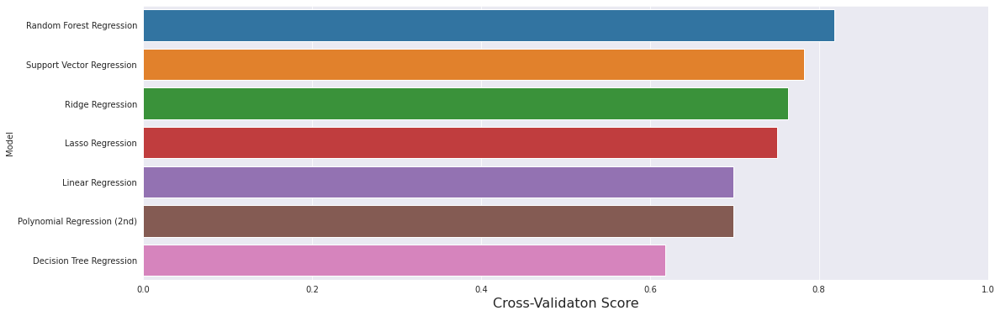

In [68]:
f, axe = plt.subplots(1,1, figsize=(18,6))

predict.sort_values(by=['Cross-Validation'], ascending=False, inplace=True)

sns.barplot(x='Cross-Validation', y='Model', data = predict, ax = axe)
#axes[0].set(xlabel='Region', ylabel='Charges')
axe.set_xlabel('Cross-Validaton Score', size=16)
axe.set_ylabel('Model')
axe.set_xlim(0,1.0)
plt.show()

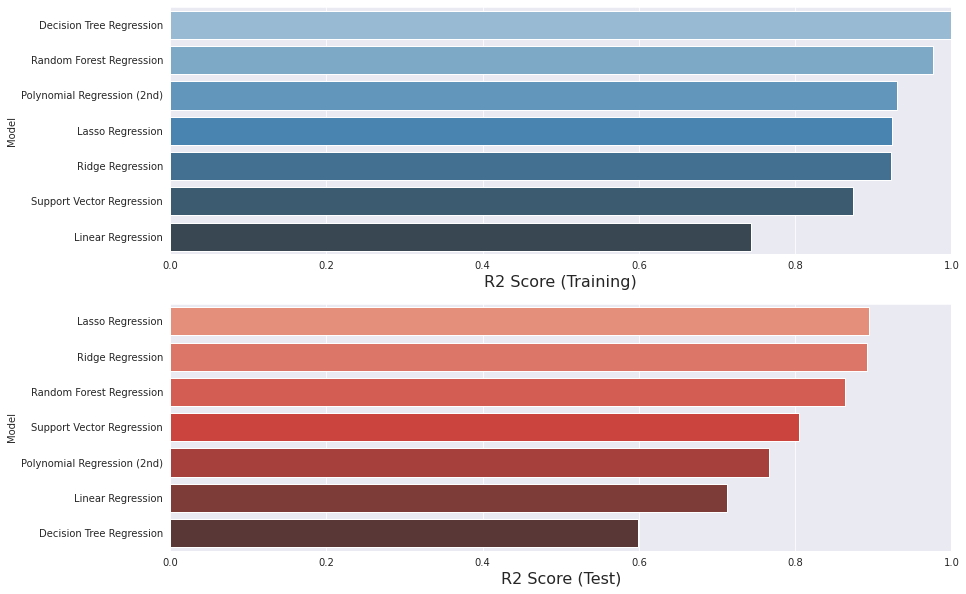

In [69]:
f, axes = plt.subplots(2,1, figsize=(14,10))

predict.sort_values(by=['R2_Score(training)'], ascending=False, inplace=True)

sns.barplot(x='R2_Score(training)', y='Model', data = predict, palette='Blues_d', ax = axes[0])
#axes[0].set(xlabel='Region', ylabel='Charges')
axes[0].set_xlabel('R2 Score (Training)', size=16)
axes[0].set_ylabel('Model')
axes[0].set_xlim(0,1.0)

predict.sort_values(by=['R2_Score(test)'], ascending=False, inplace=True)

sns.barplot(x='R2_Score(test)', y='Model', data = predict, palette='Reds_d', ax = axes[1])
#axes[0].set(xlabel='Region', ylabel='Charges')
axes[1].set_xlabel('R2 Score (Test)', size=16)
axes[1].set_ylabel('Model')
axes[1].set_xlim(0,1.0)

plt.show()

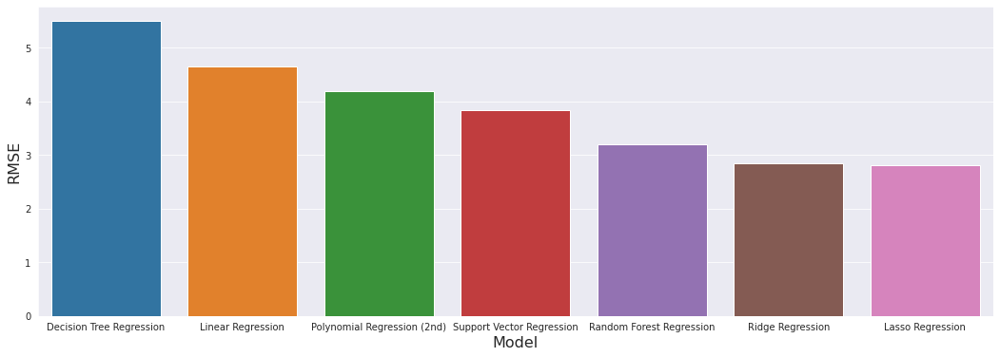

In [70]:
predict.sort_values(by=['RMSE'], ascending=False, inplace=True)

f, axe = plt.subplots(1,1, figsize=(18,6))
sns.barplot(x='Model', y='RMSE', data=predict, ax = axe)
axe.set_xlabel('Model', size=16)
axe.set_ylabel('RMSE', size=16)

plt.show()

**NEURAL NETWORK REGRESSION**

Numero de ejemplos = 506
X Shape = (506, 13)
y Shape = 506

Index(['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD', 'TAX',
       'PTRATIO', 'B', 'LSTAT'],
      dtype='object')
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 128)               1792      
                                                                 
 dense_7 (Dense)             (None, 64)                8256      
                                                                 
 dense_8 (Dense)             (None, 1)                 65        
                                                                 
Total params: 10,113
Trainable params: 10,113
Non-trainable params: 0
_________________________________________________________________
        CRIM    ZN  INDUS  CHAS    NOX     RM   AGE     DIS  RAD    TAX  \
0    0.00632  18.0   2.31   0.0  0.538  6.575

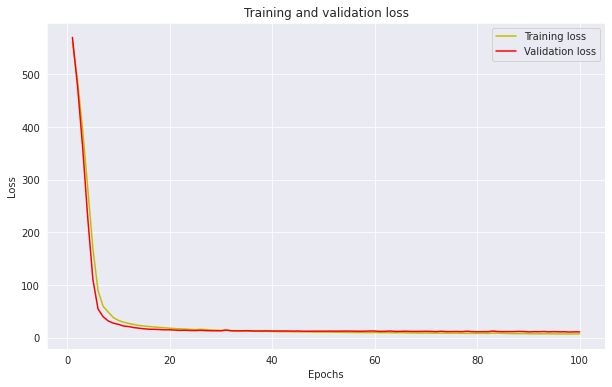

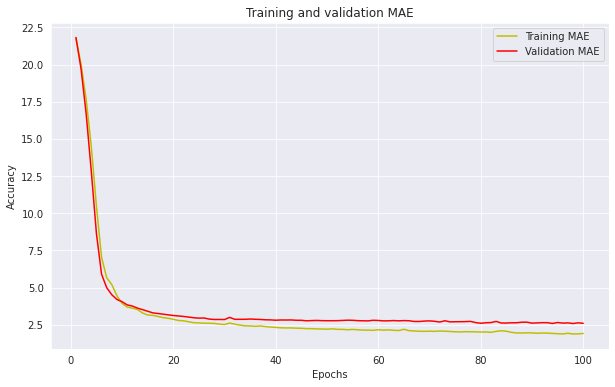

Predicted values are:  [[18.823442]
 [19.961866]
 [20.410686]
 [20.839497]
 [13.468984]]
Real values are:  498    21.2
94     20.6
150    21.5
221    21.7
423    13.4
Name: PRICE, dtype: float64
4/4 [==============================] - 0s 3ms/step - loss: 15.3139 - mean_absolute_error: 2.8986
Mean squared error from neural net:  15.313909530639648
Mean absolute error from neural net:  2.898577928543091


In [73]:
import pandas as pd

from pandas import read_csv
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_boston

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

boston_dataset = load_boston()
df = pd.DataFrame(boston_dataset.data, columns = boston_dataset.feature_names)

df.name = 'Conjunto Total' 

print('Numero de ejemplos = {}'.format(df.shape[0]))
print('X Shape = {}'.format(df.shape))
print('y Shape = {}\n'.format(df.shape[0]))
print(df.columns)

df.isnull().sum()

df['MEDV'] = boston_dataset.target
df = df.rename(columns={'MEDV': 'PRICE'})
X = df.drop('PRICE', axis = 1)
y = df['PRICE']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 20)


#Scalamos la data, caso contrario el modelo fallara
#Standardize features by removing the mean and scaling to unit variance
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
scaler.fit(X_train)

X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)


# Definimos el modelo
#Experimentamos con redes profundas y anchas
model = Sequential()
model.add(Dense(128, input_dim=13, activation='relu'))
model.add(Dense(64, activation='relu'))
#Output layer
model.add(Dense(1, activation='linear'))

model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_absolute_error'])
model.summary()

print(df)
history = model.fit(X_train_scaled, y_train, validation_split=0.2, epochs =100)

from matplotlib import pyplot as plt
#ploteamos la exactitud del entrenamiento y prueba y perdida en cada epoca
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)

plt.figure(figsize = (10,6))
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


acc = history.history['mean_absolute_error']
val_acc = history.history['val_mean_absolute_error']

plt.figure(figsize = (10,6))
plt.plot(epochs, acc, 'y', label='Training MAE')
plt.plot(epochs, val_acc, 'r', label='Validation MAE')
plt.title('Training and validation MAE')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

############################################
#Predict on test data
predictions = model.predict(X_test_scaled[:5])
print("Predicted values are: ", predictions)
print("Real values are: ", y_test[:5])
##############################################

#Comparison with other models..
#Neural network - from the current code
mse_neural, mae_neural = model.evaluate(X_test_scaled, y_test)
print('Mean squared error from neural net: ', mse_neural)
print('Mean absolute error from neural net: ', mae_neural)

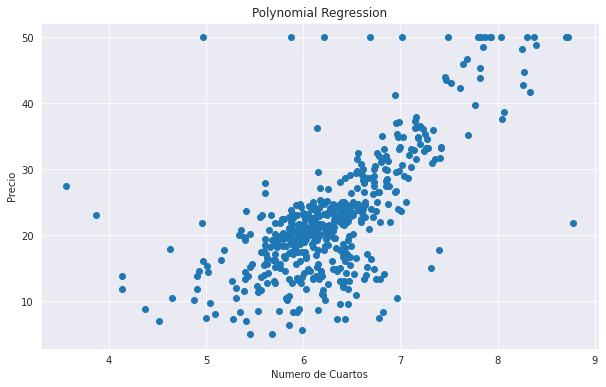

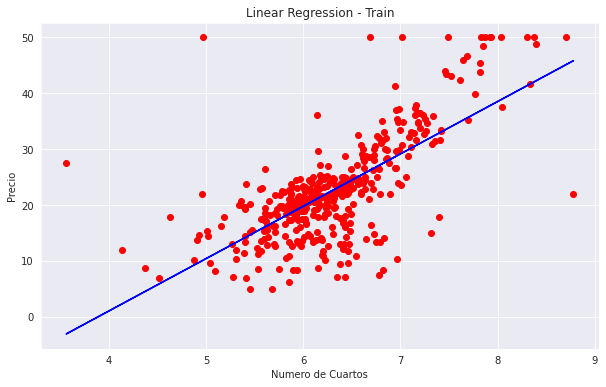

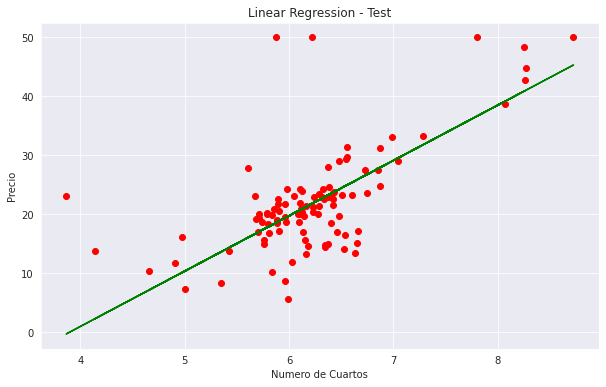

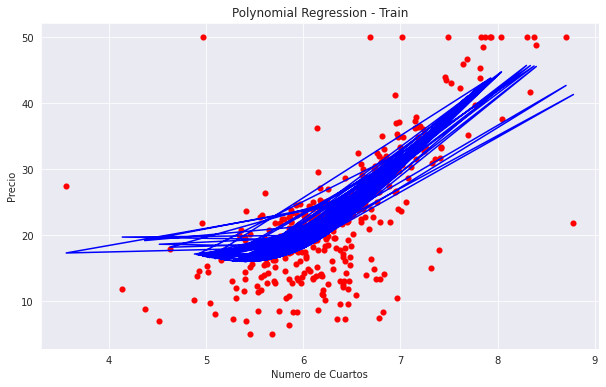

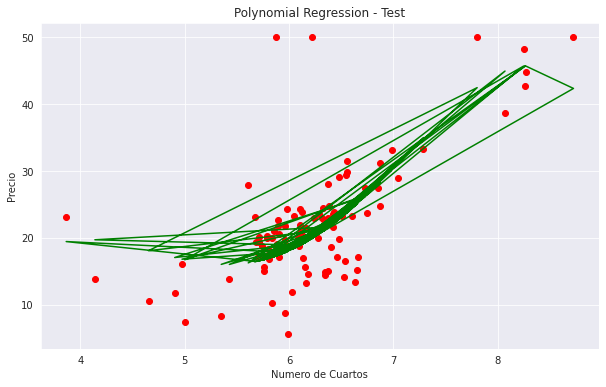

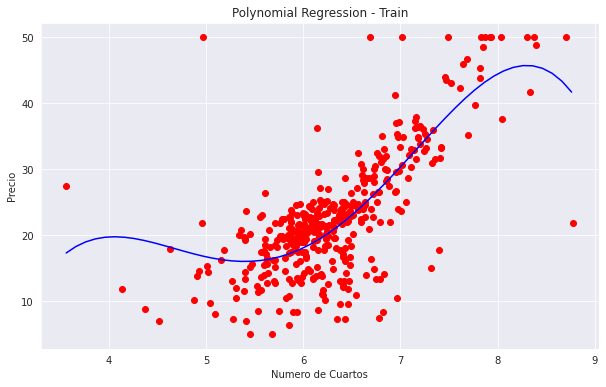

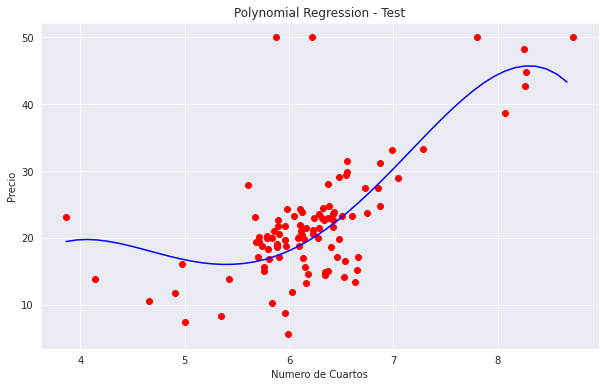

[   0.          474.76366216 -131.08855159   15.45838577   -0.65297514]
-604.083982376721
0.5911801109284439


In [74]:
# Polynomial Regression

# Importing the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.datasets import load_boston

# Importing the dataset
boston_dataset = load_boston()
dataset = pd.DataFrame(boston_dataset.data, columns = boston_dataset.feature_names)
dataset['MEDV'] = boston_dataset.target #Agregamos el target a la data
##print(dataset)
X = boston_dataset.data[:, np.newaxis, 5] #Asignamos la columna RM a X
y = boston_dataset.target                 #Asignamos la columna traget a y
##X = dataset.iloc[:, 5:6].values #Asignamos la primera columna a X
##y = dataset.iloc[:, 13].values  #Asignamos la columna traget a y

#print(X)
#print(y)

#Grafiquemos los datos
plt.scatter(X, y)
plt.title('Polynomial Regression')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

# Feature Scaling
"""from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)"""

# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures
poly_reg = PolynomialFeatures(degree = 4)

X_poly_train = poly_reg.fit_transform(X_train)
X_poly_test = poly_reg.fit_transform(X_test)

#poly_reg.fit(X_poly_train, y_train)

lin_reg_2 = LinearRegression()
lin_reg_2.fit(X_poly_train, y_train)

#Se ejecuta una prediccion
y_pred_poly_reg = lin_reg_2.predict(X_poly_test)

#print(y_pred_poly_reg)
#print(y_test)

# Visualising the Linear Regression results
plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_train, lin_reg.predict(X_train), color = 'blue')
plt.title('Linear Regression - Train')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Visualising the Linear Regression results
plt.scatter(X_test, y_test, color = 'red')
plt.plot(X_test, lin_reg.predict(X_test), color = 'green')
plt.title('Linear Regression - Test')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Visualising the Polynomial Regression results
plt.scatter(X_train, y_train, color = 'red', linewidth = 0.1)
plt.plot(X_train, lin_reg_2.predict(poly_reg.fit_transform(X_train)), color = 'blue')
plt.title('Polynomial Regression - Train')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Visualising the Polynomial Regression results
plt.scatter(X_test, y_test, color = 'red', linewidth = 1)
plt.plot(X_test, lin_reg_2.predict(poly_reg.fit_transform(X_test)), color = 'green')
plt.title('Polynomial Regression - Test')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Visualising the Polynomial Regression results (for higher resolution and smoother curve)
X_grid = np.arange(min(X_train), max(X_train), 0.1)
X_grid = X_grid.reshape((len(X_grid), 1))
plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_grid, lin_reg_2.predict(poly_reg.fit_transform(X_grid)), color = 'blue')
plt.title('Polynomial Regression - Train')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Visualising the Polynomial Regression results (for higher resolution and smoother curve)
X_grid = np.arange(min(X_test), max(X_test), 0.1)
X_grid = X_grid.reshape((len(X_grid), 1))
plt.scatter(X_test, y_test, color = 'red')
plt.plot(X_grid, lin_reg_2.predict(poly_reg.fit_transform(X_grid)), color = 'blue')
plt.title('Polynomial Regression - Test')
plt.xlabel('Numero de Cuartos')
plt.ylabel('Precio')
plt.show()

# Predicting a new result with Linear Regression
#lin_reg.predict(6.5)

# Predicting a new result with Polynomial Regression
#lin_reg_2.predict(poly_reg.fit_transform(6.5))
print(lin_reg_2.coef_)
print(lin_reg_2.intercept_)
print(lin_reg_2.score(X_poly_train, y_train))

In [75]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Importing the dataset
dataset = pd.read_csv('https://s3.us-west-2.amazonaws.com/public.gamelab.fun/dataset/position_salaries.csv')
print(dataset)
X = dataset.iloc[:, 1:2].values
y = dataset.iloc[:, 2].values

            Position  Level   Salary
0   Business Analyst      1    45000
1  Junior Consultant      2    50000
2  Senior Consultant      3    60000
3            Manager      4    80000
4    Country Manager      5   110000
5     Region Manager      6   150000
6            Partner      7   200000
7     Senior Partner      8   300000
8            C-level      9   500000
9                CEO     10  1000000


In [76]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)


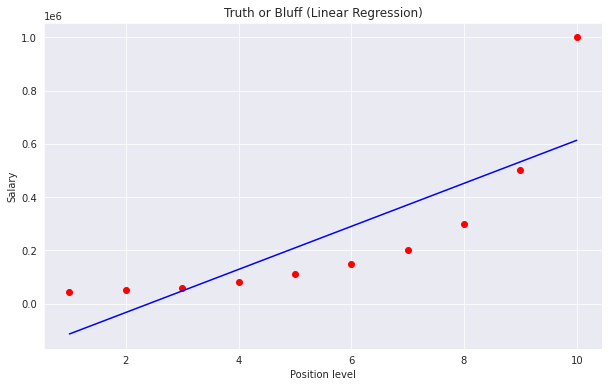

In [77]:
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X, y)

# Visualizing the Linear Regression results
def viz_linear():
    plt.scatter(X, y, color='red')
    plt.plot(X, lin_reg.predict(X), color='blue')
    plt.title('Truth or Bluff (Linear Regression)')
    plt.xlabel('Position level')
    plt.ylabel('Salary')
    plt.show()
    return
viz_linear()

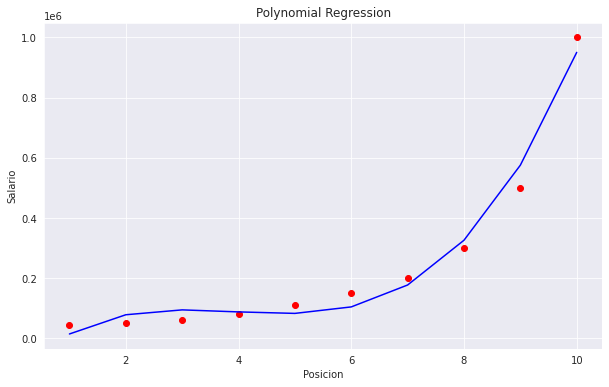

In [79]:

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures
poly_reg = PolynomialFeatures(degree=3)
X_poly = poly_reg.fit_transform(X)
pol_reg = LinearRegression()
pol_reg.fit(X_poly, y)

# Visualizing the Polymonial Regression results
def viz_polymonial():
    plt.scatter(X, y, color='red')
    plt.plot(X, pol_reg.predict(poly_reg.fit_transform(X)), color='blue')
    plt.title('Polynomial Regression')
    plt.xlabel('Posicion')
    plt.ylabel('Salario')
    plt.show()
    return
viz_polymonial()

In [80]:
# Predicting a new result with Linear Regression
lr_pred = lin_reg.predict([[5.5]])
#output should be 249500
print(lr_pred)

# Predicting a new result with Polymonial Regression
pr_pred = pol_reg.predict(poly_reg.fit_transform([[5.5]]))
#output should be 132148.43750003
print(pr_pred)

[249500.]
[89187.5]


**Support Vector Regression**

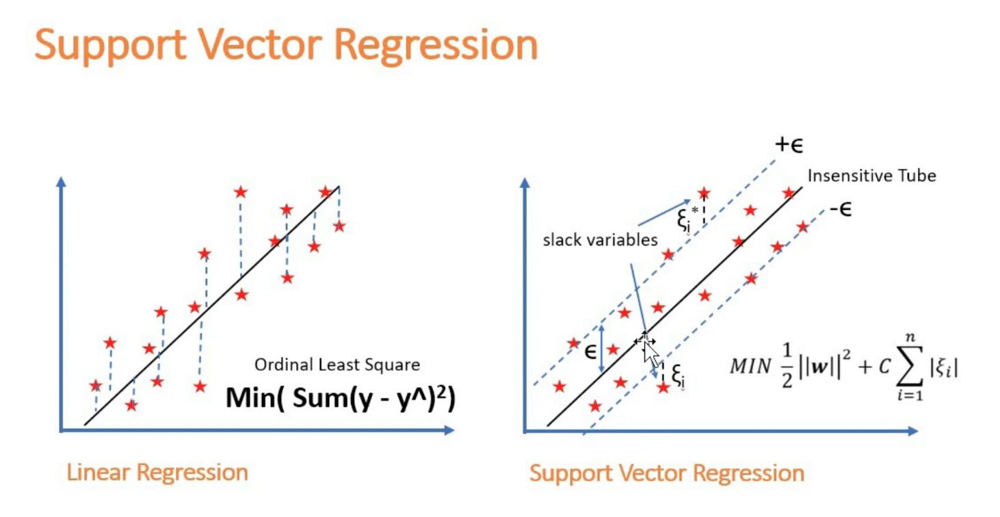

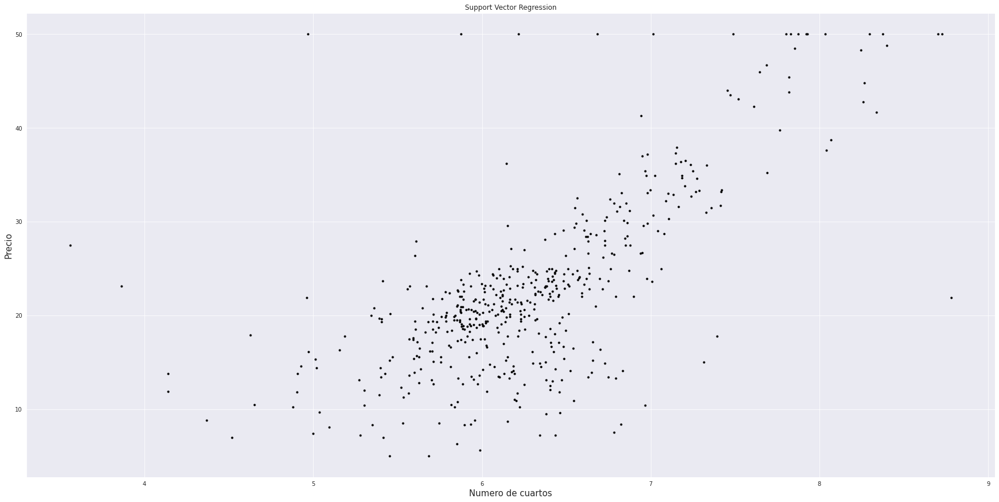

1
0
Root Mean Squared Error: 7.402435284635017
Coefficient of determination (R2): 0.35090812320970133


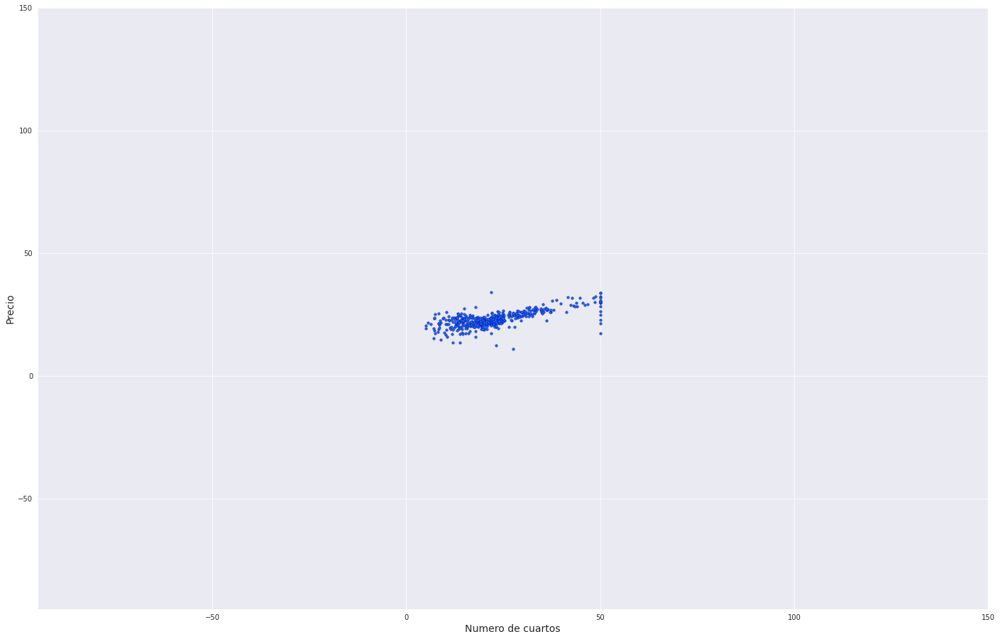

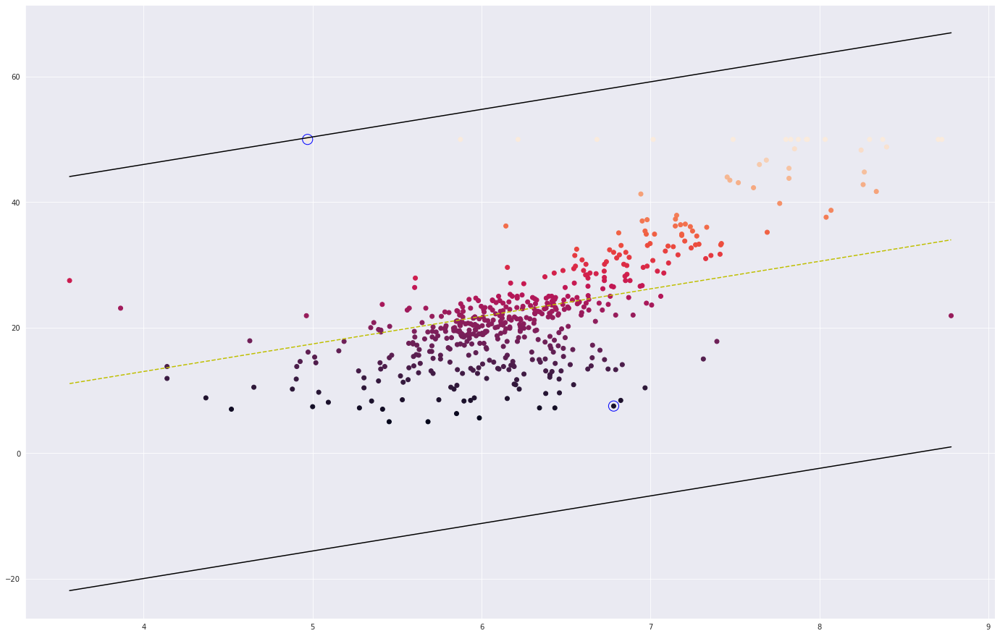

In [81]:
import pandas as pd
import numpy as np
from pandas import DataFrame
from sklearn import metrics
from sklearn.datasets import load_boston

##Data = pd.read_csv("Data.txt",delimiter="\t")
# Importing the dataset
boston_dataset = load_boston()
dataset = pd.DataFrame(boston_dataset.data, columns = boston_dataset.feature_names)
dataset['MEDV'] = boston_dataset.target #Agregamos el target a la data
##print(dataset)
X = boston_dataset.data[:, np.newaxis, 5] #Asignamos la columna RM a X
y = boston_dataset.target
#print(y)

##X=Data['waterlevel(x)'].values
##y=Data['Area(y)'].values


# Plot Data
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1, 1,constrained_layout=True,figsize=(24, 12))
ax.plot(X, y,'k.')
ax.set_title('Support Vector Regression')
ax.set_xlabel('Numero de cuartos',fontsize=15)
ax.set_ylabel('Precio',fontsize=15)
#plt.axis([0, 25, 0, 25])
plt.grid(True)
plt.show()

# find max and min values of predictor variables (here X) to use it to specify initial values of w and b 

max_feature_value=np.amax(X)
min_feature_value=np.amin(X)

w_optimum = max_feature_value*0.5


w = [w_optimum for i in range(1)]   # w shoulb be a vector with dimension of the independent features (here:1)
wt_b=w

b_sum=0
for i in range(X.shape[0]):
    b_sum+=y[i]-np.dot(wt_b,X[i])

b_ini=b_sum/len(X)

b_step_size_lower = 0.9
b_step_size_upper = 0.1
#b_multiple = 500   # step size for b
b_multiple = 500   # step size for b
b_range = np.arange((b_ini*b_step_size_lower), -b_ini*b_step_size_upper, b_multiple)
print(len(b_range))


# Estimate w and b using stochastic gradient descent and trial and error
l_rate=0.1
n_epoch = 250
#epsilon=500 # acceptable error
epsilon=33 # acceptable error
length_Wvector_list=[]

for i in range (len(b_range)):
    print(i)
    optimized = False
    while not optimized:
        correctly_regressed = True
        for j in range(X.shape[0]):
            # every data point should be satisfies the constraint  yi-(np.dot(w_t,xi)+b) <=epsilon or yi-(np.dot(w_t,xi)+b)>=-epsilon 
            if (y[j]-(np.dot(wt_b,X[j])+b_range[i]) > epsilon) or (y[j]-(np.dot(wt_b,X[j])+b_range[i]) < -epsilon)==True:
                correctly_regressed = False
                wt_b = np.asarray(wt_b) - l_rate      

        if correctly_regressed==True:
            length_Wvector_list.append([wt_b[0],wt_b,b_range[i]]) #store w, b for minimum magnitude , magnitude or length of a vector w_t is called the norm
            optimized = True
        if wt_b[0] < 0:
            optimized = True           

    wt_b_temp=wt_b
    wt_b=w


norms = sorted([n for n in length_Wvector_list])
wt_b=norms[0][1]
b=norms[0][2]

# Predict using the optimized values of w and b    
y_predict=[]
for i in range (X.shape[0]):
    y_hat=np.dot(wt_b,X[i])+b
    y_predict.append(y_hat)        


print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y, y_predict)))
print('Coefficient of determination (R2):', metrics.r2_score(y, y_predict))    

# plot 
fig,ax = plt.subplots(1, 1,figsize=(24, 15.6))
ax.scatter(y, y_predict, cmap='K', edgecolor='b',linewidth='0.5',alpha=1, label='testing points',marker='o', s=12)
ax.set_xlabel('Numero de cuartos',fontsize=14)
ax.set_ylabel('Precio',fontsize=14)
ax.set_xlim([min(y)-100, max(y)+100])
ax.set_ylim([min(y)-100, max(y)+100])


# find support vectors
positive_instances=[]
negative_instances=[]


for i in range(X.shape[0]):
    y_pre=(np.dot(wt_b,X[i]))+b
    if  ((y[i]-y_pre>0) and (y[i]-y_pre<=epsilon))==True:
        positive_instances.append([y[i]-y_pre,[X[i],y[i]]])
    elif ((y[i]-y_pre<0) and (y[i]-y_pre>=-epsilon))==True:
        negative_instances.append([y[i]-y_pre,[X[i],y[i]]]) 

len(positive_instances)+len(negative_instances)

sort_positive=sorted([n for n in positive_instances])
sort_negative=sorted([n for n in negative_instances])

positive_support_vector=sort_positive[-1][1]
negative_support_vector=sort_negative[0][1]

model_support_vectors=np.stack((positive_support_vector,negative_support_vector),axis=-1)



# visualize the data-set

colors = {1:'r',-1:'b'}
fig = plt.figure(figsize=(24, 15.6))
ax = fig.add_subplot(1,1,1)

plt.scatter(X,y,marker='o',c=y)

# plot support vectors
ax.scatter(model_support_vectors[0, :],model_support_vectors[1, :],s=200, linewidth=1,facecolors='none', edgecolors='b')

# hyperplane = x.w+b
# 0 = x.w+b
# psv = epsilon
# nsv = -epsilon
# dec = 0

def hyperplane_value(x,w,b,e):
    return (np.dot(w,x)+b+e)

datarange = (min_feature_value*1.,max_feature_value*1.)
hyp_x_min = datarange[0]
hyp_x_max = datarange[1]

# (w.x+b) = epsilon
# positive support vector hyperplane
psv1 = hyperplane_value(hyp_x_min, wt_b, b, epsilon)
psv2 = hyperplane_value(hyp_x_max, wt_b, b, epsilon)
ax.plot([hyp_x_min,hyp_x_max],[psv1,psv2], 'k')

# (w.x+b) = -epsilon
# negative support vector hyperplane
nsv1 = hyperplane_value(hyp_x_min, wt_b, b, -epsilon)
nsv2 = hyperplane_value(hyp_x_max, wt_b, b, -epsilon)
ax.plot([hyp_x_min,hyp_x_max],[nsv1,nsv2], 'k')

# (w.x+b) = 0
# positive support vector hyperplane
db1 = hyperplane_value(hyp_x_min, wt_b, b, 0)
db2 = hyperplane_value(hyp_x_max, wt_b, b, 0)
ax.plot([hyp_x_min,hyp_x_max],[db1,db2], 'y--')

#plt.axis([-5,10,-12,-1])
plt.show()

**Decision Tree Regression**

Imagenes tomadas con propositos educativos de:
https://www.youtube.com/watch?v=UhY5vPfQIrA

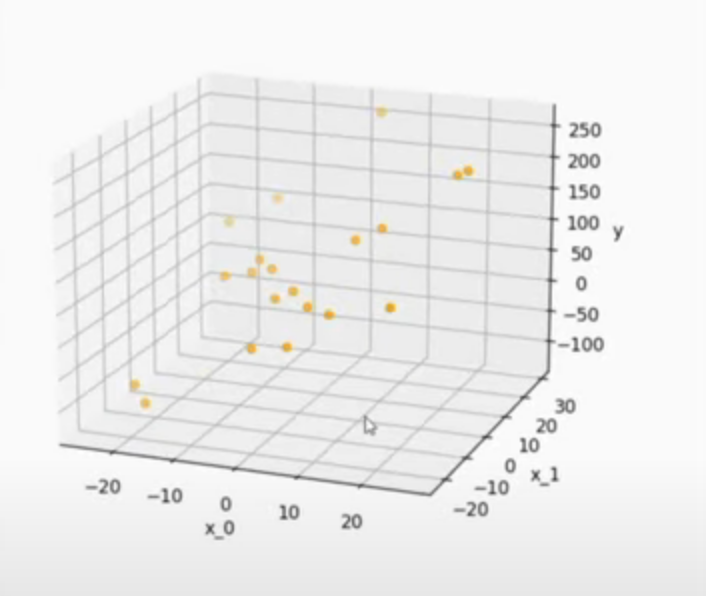

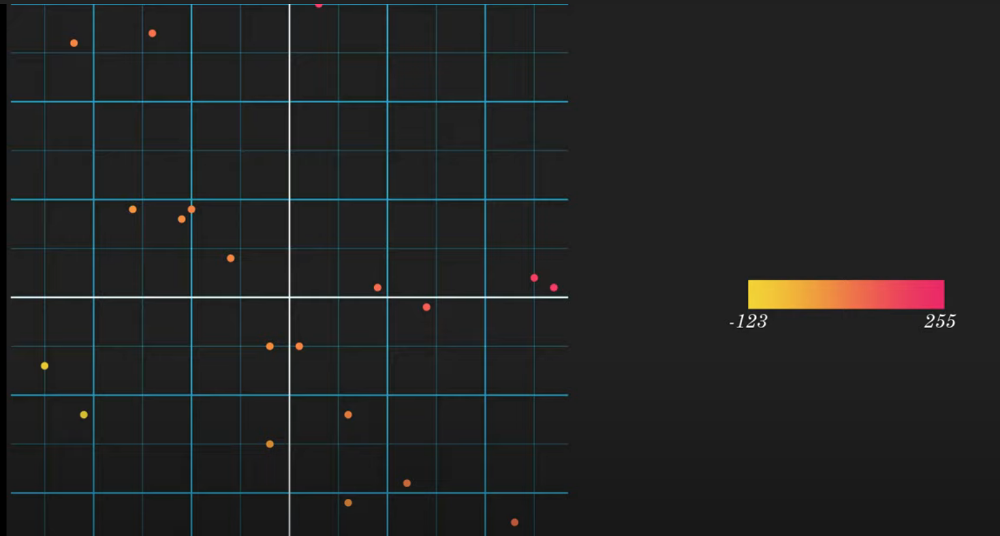

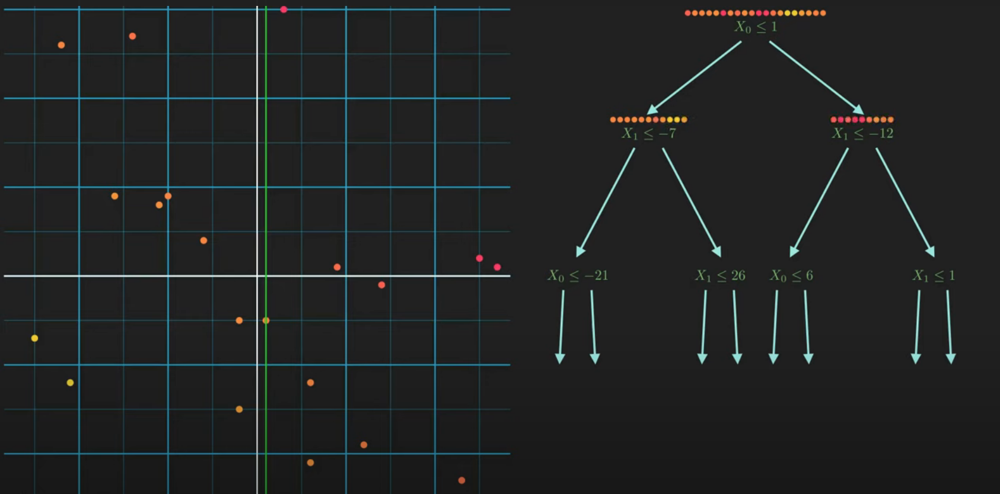

La impureza de los nodos se va reduciendo

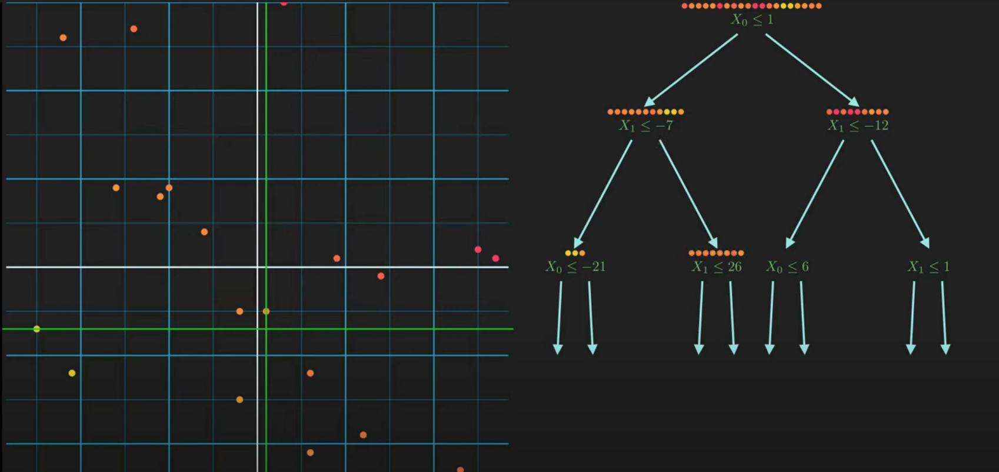

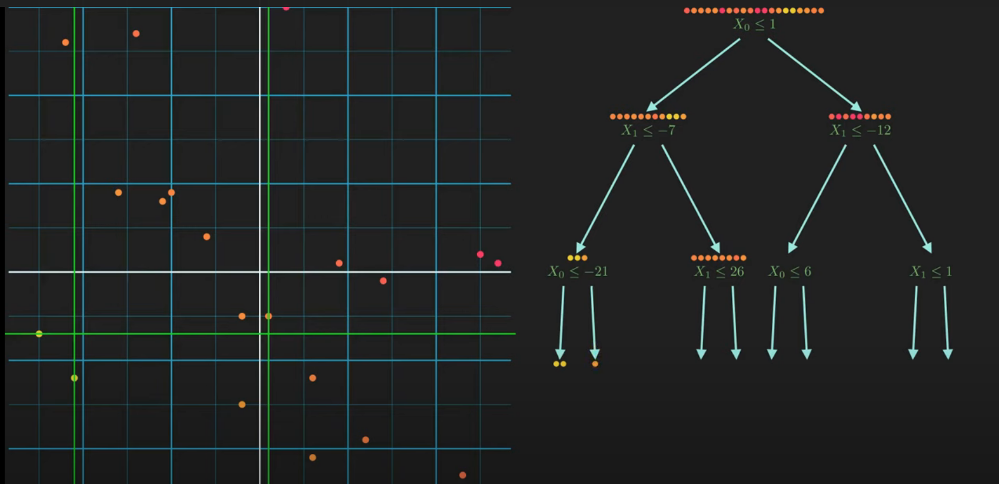

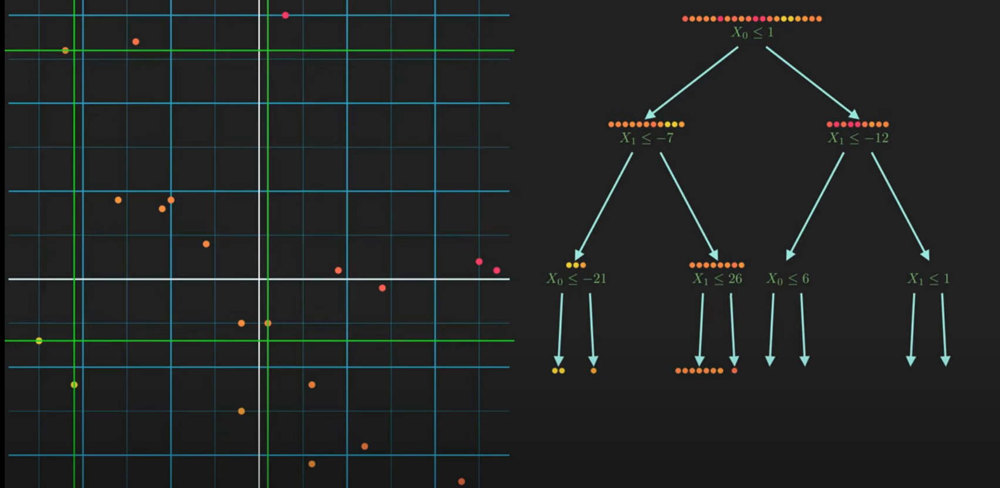

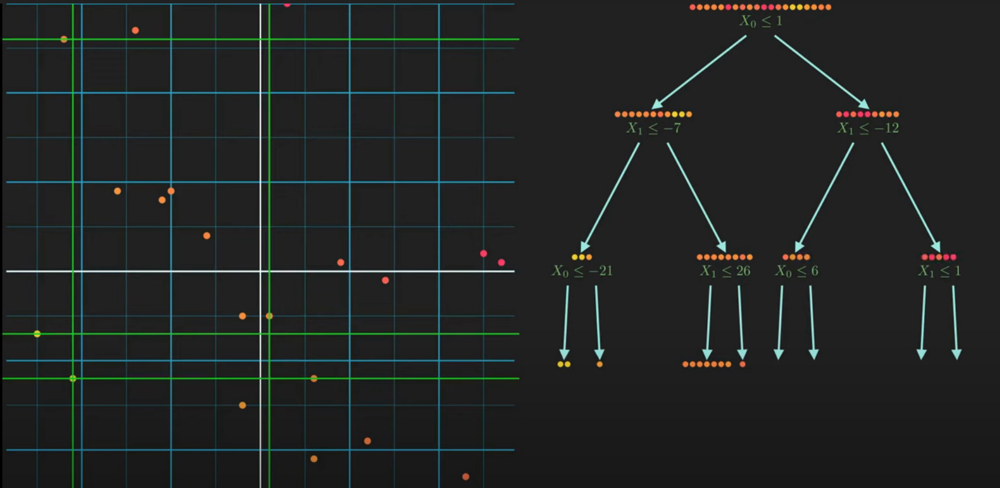

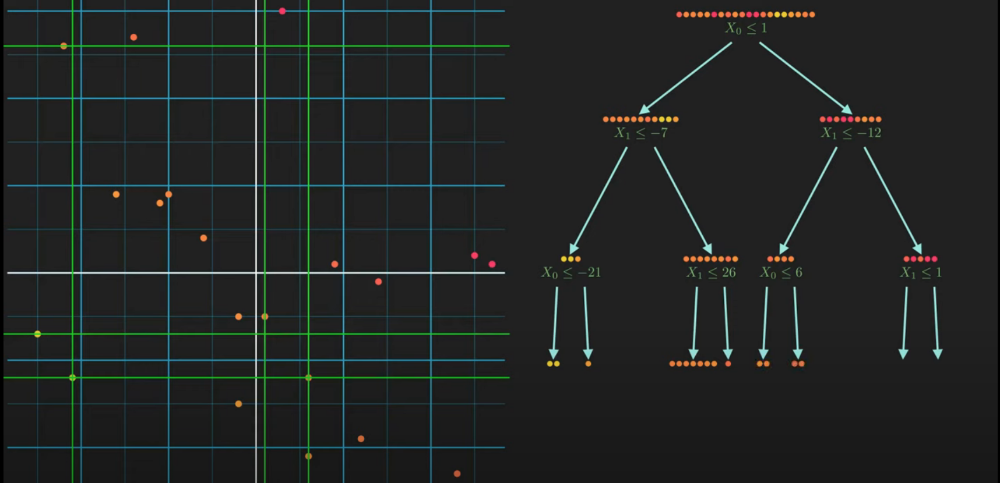

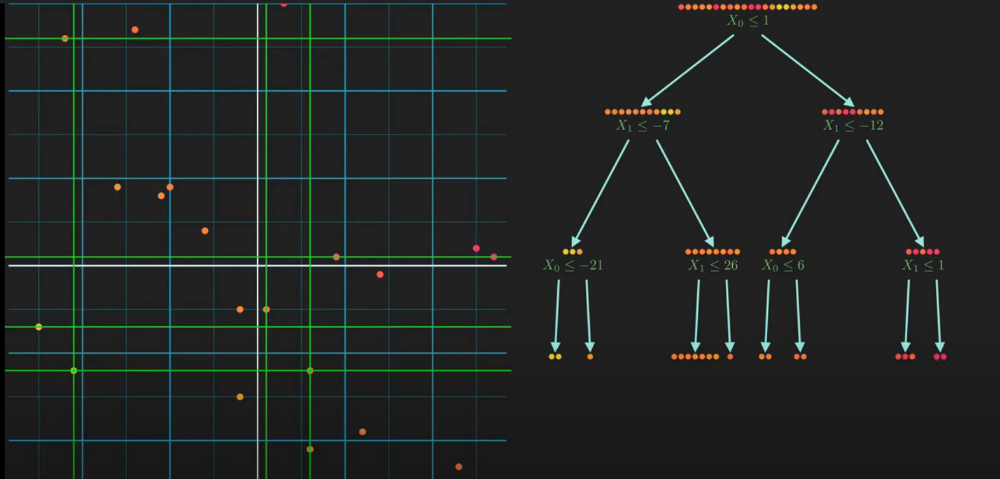

Ahora ya tenemos el arbol de regresion completo con sus correspondientes divisiones.
¿Como predecimos el valor de y para una nuevo punto?

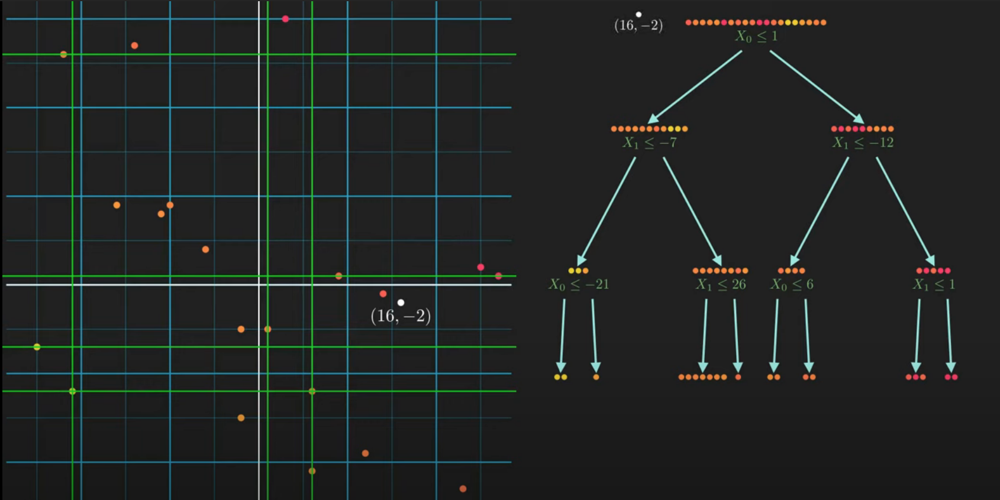

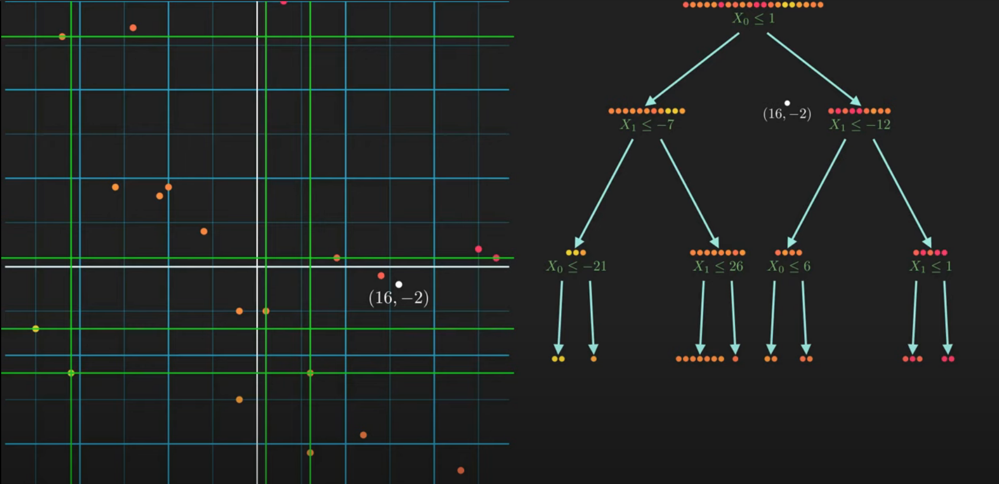

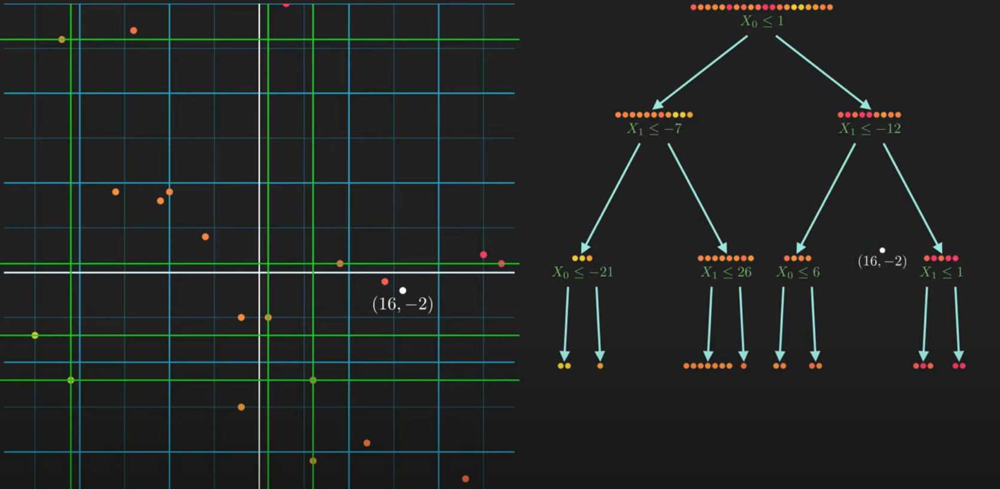

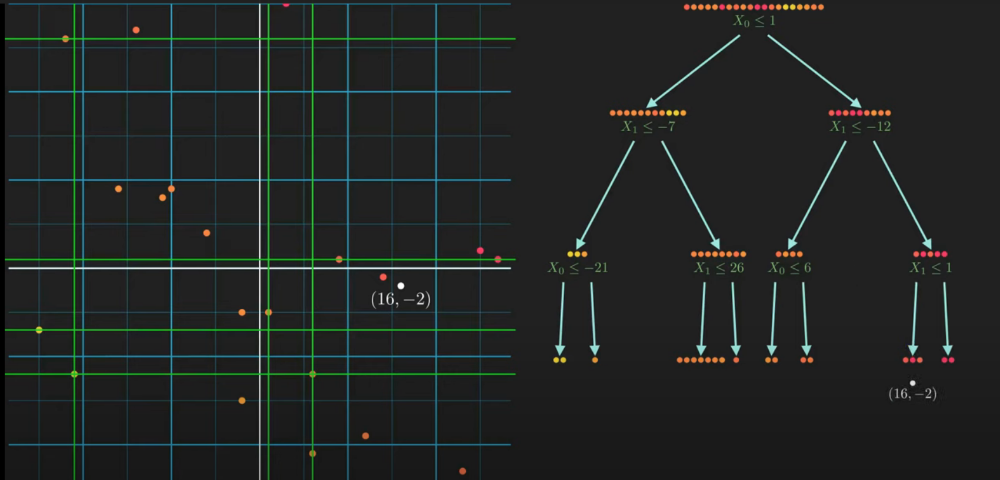

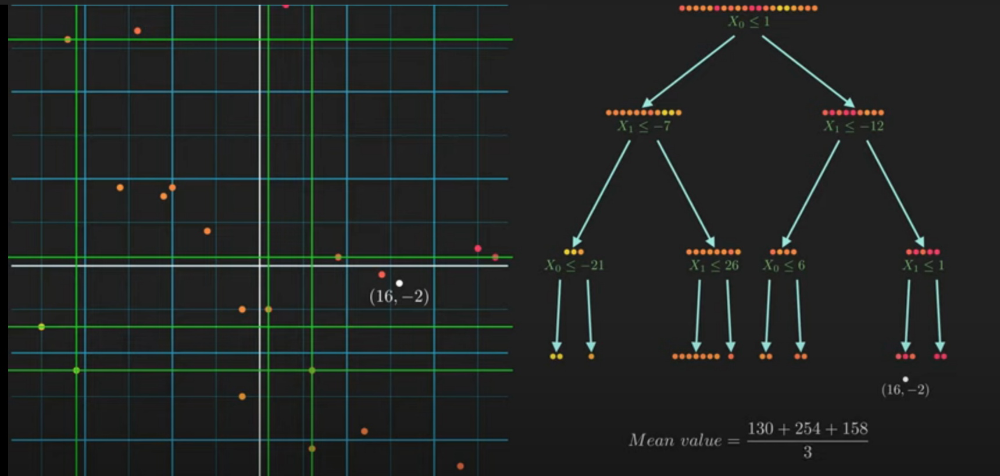

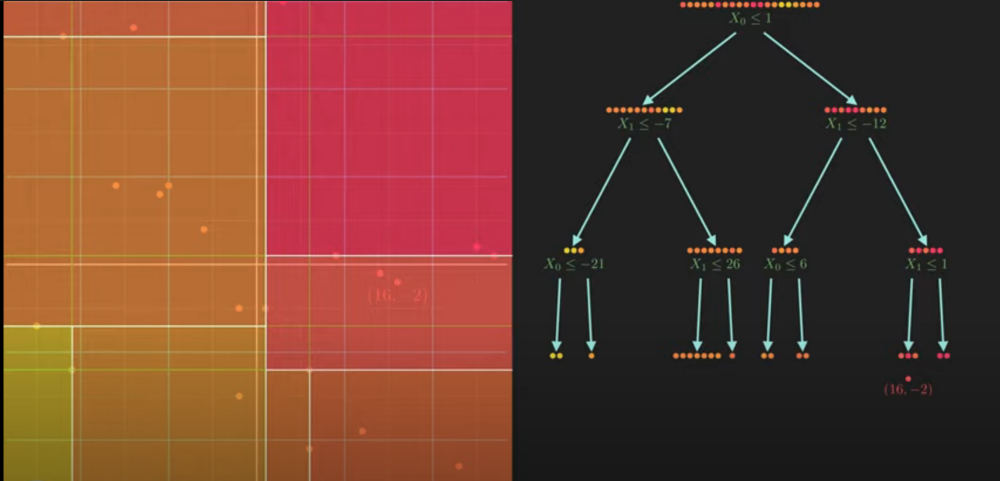

**Pero lo mas importante ¿Como el algoritmo divide el data set?**

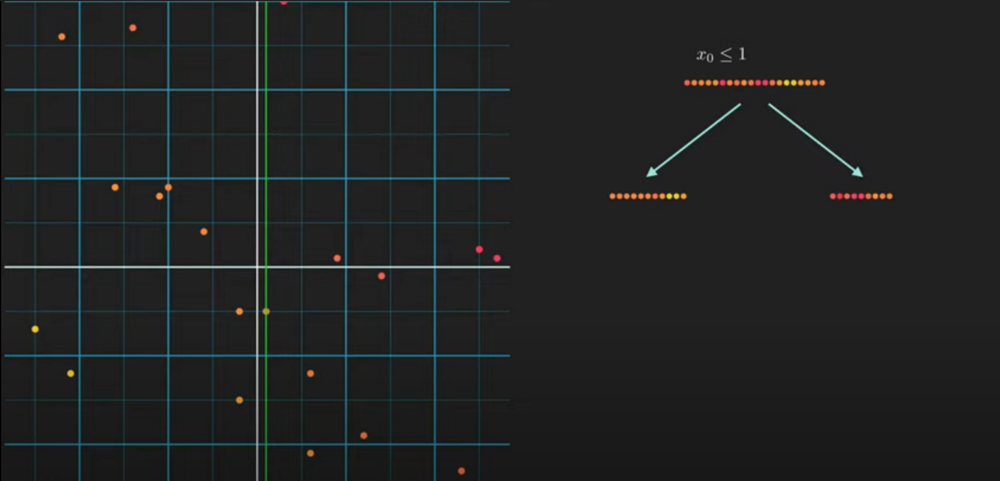

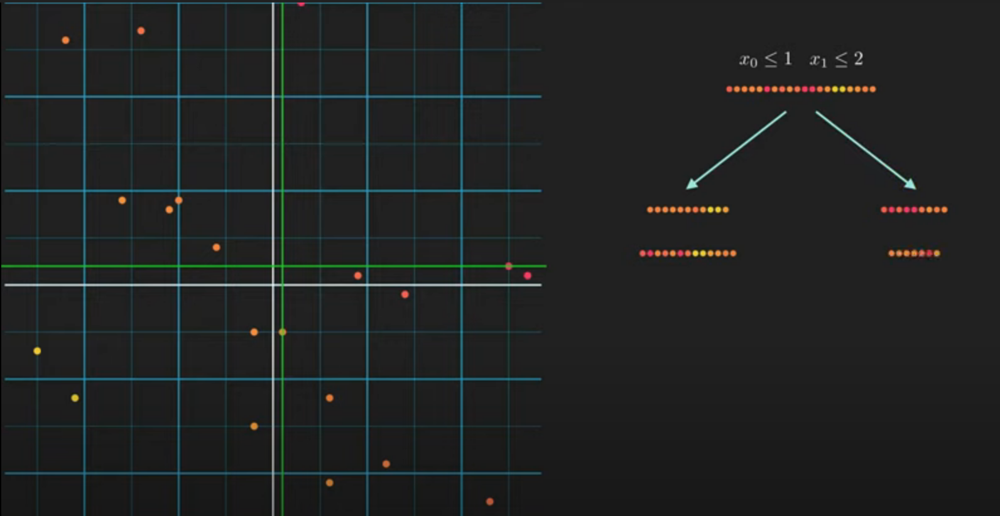

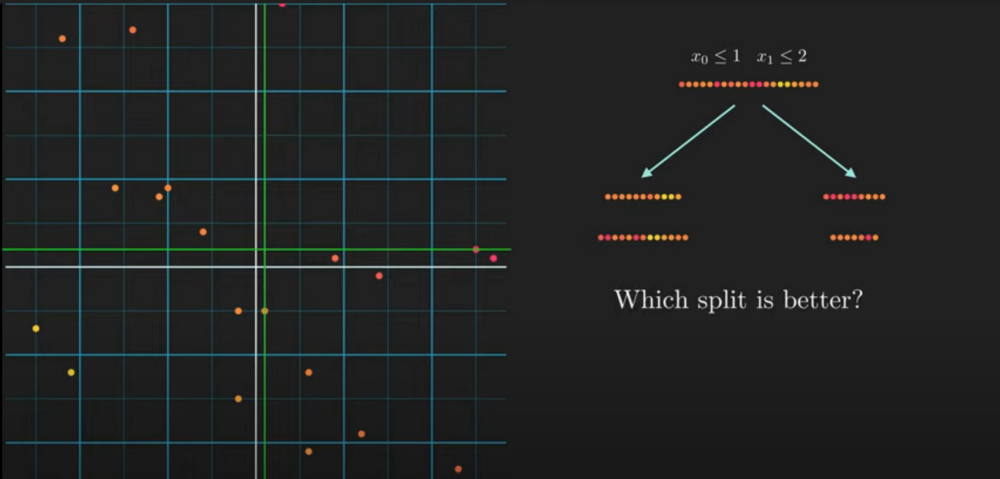

Usaremos la varianza como medida de la impureza, debemos reducir la impureza.

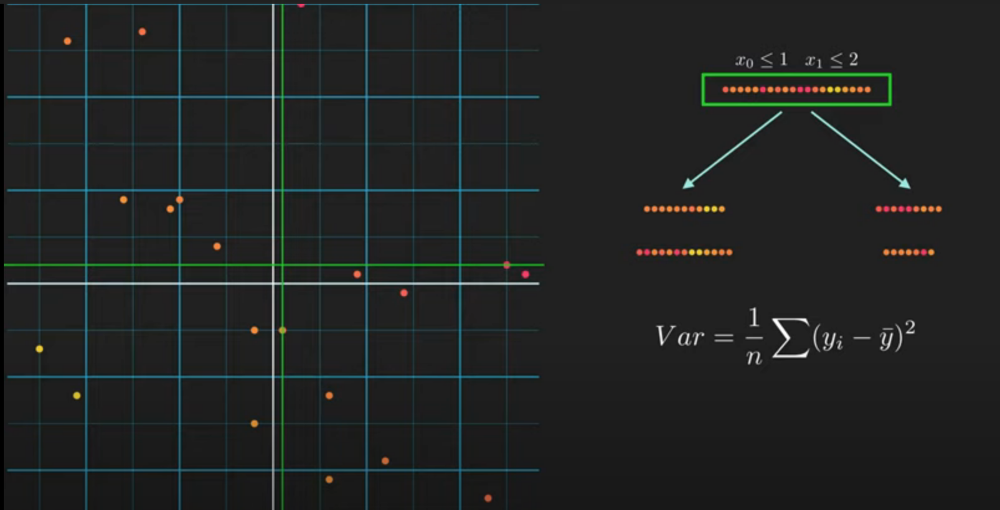

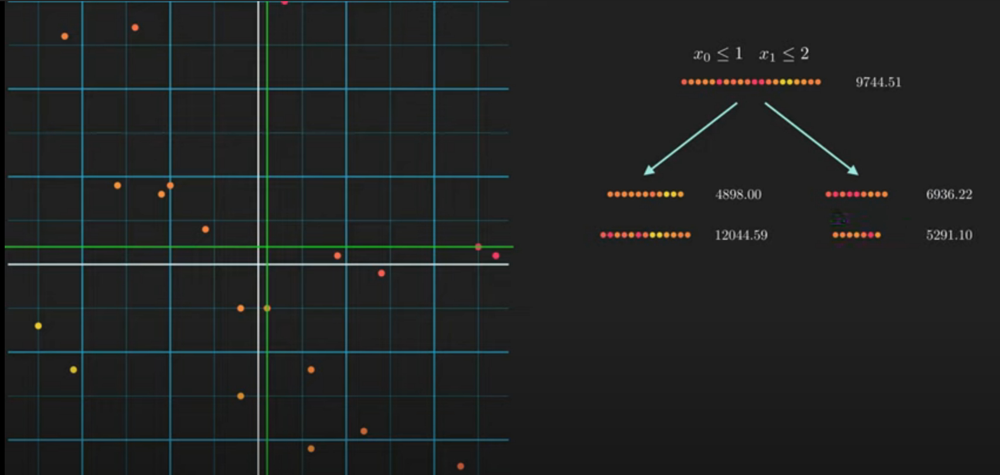

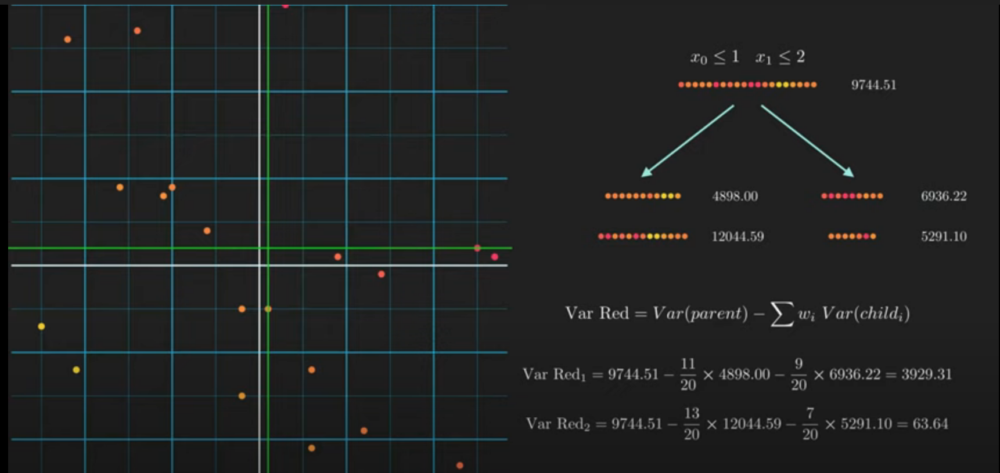

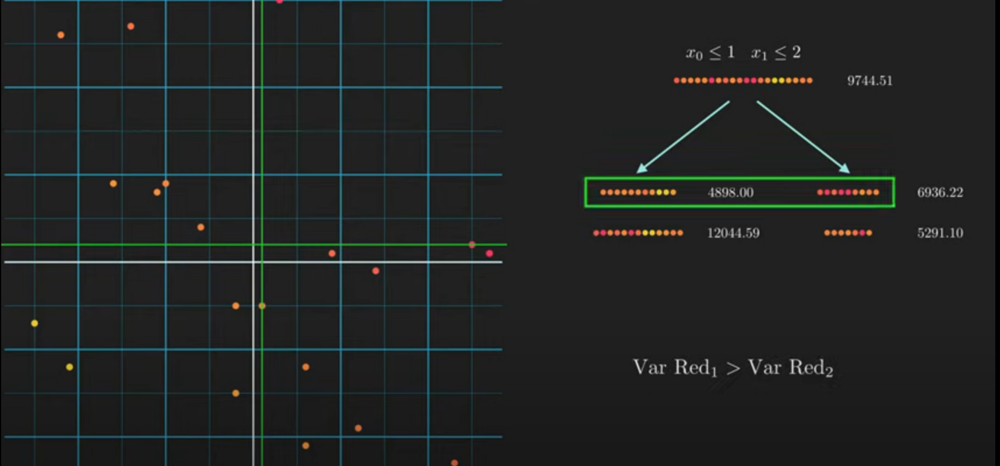

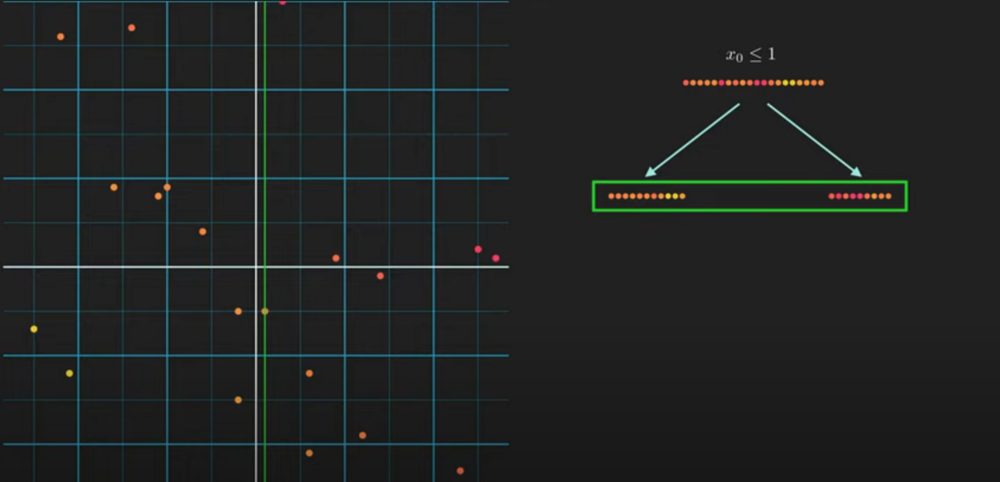

Una implementacion from "scratch" de este algoritmo lo pueden revisasr en el siguiente link:

https://github.com/Suji04/ML_from_Scratch/blob/master/decision%20tree%20regression.ipynb


In [82]:

# import numpy package for arrays and stuff
import numpy as np 
  
# import matplotlib.pyplot for plotting our result
import matplotlib.pyplot as plt
  
# import pandas for importing csv files 
import pandas as pd 

In [83]:
# import dataset
# dataset = pd.read_csv('Data.csv')
# alternatively open up .csv file to read data

'''dataset = np.array(
[['Asset Flip', 100, 1000],
['Text Based', 500, 3000],
['Visual Novel', 1500, 5000],
['2D Pixel Art', 3500, 8000],
['2D Vector Art', 5000, 6500],
['Strategy', 6000, 7000],
['First Person Shooter', 8000, 15000],
['Simulator', 9500, 20000],
['Racing', 12000, 21000],
['RPG', 14000, 25000],
['Sandbox', 15500, 27000],
['Open-World', 16500, 30000],
['MMOFPS', 25000, 52000],
['MMORPG', 30000, 80000]
])'''


dataset = np.array(
[['Asset Flip', 100, 1000],
['Text Based', 500, 3000],
['Visual Novel', 1500, 5000],
['2D Pixel Art', 3500, 8000],
['2D Vector Art', 5000, 6500],
['Strategy', 6000, 54000],
['First Person Shooter', 8000, 65000],
['Simulator', 9500, 70000],
 ['OpenAI', 10000, 75000],
['Racing', 12000, 61000],
['RPG', 14000, 55000],
['Sandbox', 15500, 7000],
['Open-World', 16500, 3000],
['MMOFPS', 25000, 5200],
['MMORPG', 30000, 8000]
])

# print the dataset
print(dataset)


[['Asset Flip' '100' '1000']
 ['Text Based' '500' '3000']
 ['Visual Novel' '1500' '5000']
 ['2D Pixel Art' '3500' '8000']
 ['2D Vector Art' '5000' '6500']
 ['Strategy' '6000' '54000']
 ['First Person Shooter' '8000' '65000']
 ['Simulator' '9500' '70000']
 ['OpenAI' '10000' '75000']
 ['Racing' '12000' '61000']
 ['RPG' '14000' '55000']
 ['Sandbox' '15500' '7000']
 ['Open-World' '16500' '3000']
 ['MMOFPS' '25000' '5200']
 ['MMORPG' '30000' '8000']]


In [84]:

# select all rows by : and column 1
# by 1:2 representing features
X = dataset[:, 1:2].astype(int) 
  
# print X
print(X)

[[  100]
 [  500]
 [ 1500]
 [ 3500]
 [ 5000]
 [ 6000]
 [ 8000]
 [ 9500]
 [10000]
 [12000]
 [14000]
 [15500]
 [16500]
 [25000]
 [30000]]


In [85]:

# select all rows by : and column 2
# by 2 to Y representing labels
y = dataset[:, 2].astype(int) 
  
# print y
print(y)

[ 1000  3000  5000  8000  6500 54000 65000 70000 75000 61000 55000  7000
  3000  5200  8000]


In [86]:

# import the regressor
from sklearn.tree import DecisionTreeRegressor 
  
# create a regressor object
regressor = DecisionTreeRegressor(random_state = 0) 
  
# fit the regressor with X and Y data
regressor.fit(X, y)

DecisionTreeRegressor(random_state=0)

In [87]:
# predicting a new value
  
# test the output by changing values, like 3750
y_pred = regressor.predict([[3750]])
  
# print the predicted price
print("Predicted price: % d\n"% y_pred) 

Predicted price:  8000



In [88]:
# predicting a new value
  
# test the output by changing values, like 9950
y_pred = regressor.predict([[9950]])
  
# print the predicted price
print("Predicted price: % d\n"% y_pred) 

Predicted price:  75000



(1994,)
(1994, 1)


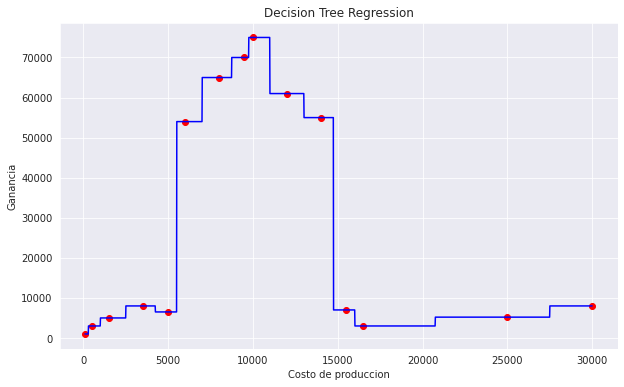

In [89]:
# arange for creating a range of values
# from min value of X to max value of X
# with a difference of 0.01 between two
# consecutive values
X_grid = np.arange(min(X), max(X), 15)
#X_grid = X
print(X_grid.shape)
# reshape for reshaping the data into
# a len(X_grid)*1 array, i.e. to make
# a column out of the X_grid values
X_grid = X_grid.reshape((len(X_grid), 1))
print(X_grid.shape)
# scatter plot for original data
plt.scatter(X, y, color = 'red')

# plot predicted data
plt.plot(X_grid, regressor.predict(X_grid), color = 'blue')

# specify title
plt.title('Decision Tree Regression')

# specify X axis label
plt.xlabel('Costo de produccion')

# specify Y axis label
plt.ylabel('Ganancia')

# show the plot
plt.show()


El árbol se exporta y se muestra en la ESTRUCTURA DEL ÁRBOL a continuación, visualizada usando http://www.webgraphviz.com/ copiando los datos del archivo 'tree.dot'.

In [91]:
# import export_graphviz
from sklearn.tree import export_graphviz

# export the decision tree to a tree.dot file
# for visualizing the plot easily anywhere
export_graphviz(regressor, out_file ='/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/tree.dot',
			feature_names =['Production Cost'])


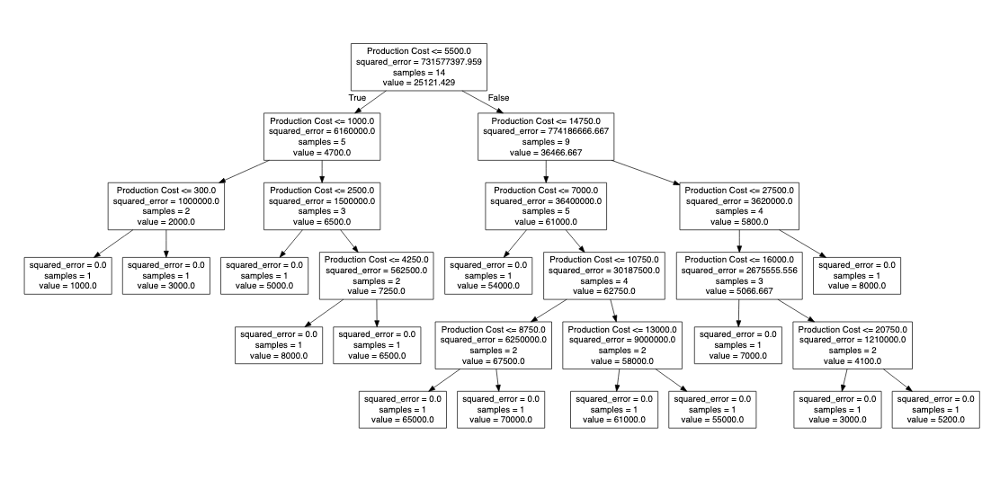

In [92]:
import numpy as np 
import matplotlib.pyplot as plt 
from sklearn.tree import DecisionTreeRegressor 
from mpl_toolkits import mplot3d
dataset = np.array( 
[['Asset Flip', 100,100, 1000], 
['Text Based', 500,300, 3000], 
['Visual Novel', 1500,500, 5000], 
['2D Pixel Art', 3500,300, 8000], 
['2D Vector Art', 5000,900, 6500], 
['Strategy', 6000,600, 7000], 
['First Person Shooter', 8000,500, 15000], 
['Simulator', 9500,400, 20000], 
['Racing', 12000,300, 21000], 
['RPG', 14000,150, 25000], 
['Sandbox', 15500,200, 27000], 
['Open-World', 16500,500, 30000], 
['MMOFPS', 25000,600, 52000], 
['MMORPG', 30000,700, 80000] 
]) 
X = dataset[:, 1:3].astype(int) 
y = dataset[:, 3].astype(int) 
regressor = DecisionTreeRegressor(random_state = 0) 
regressor.fit(X, y) 


DecisionTreeRegressor(random_state=0)

Text(0.5, 0, 'z-axis(predictions)')

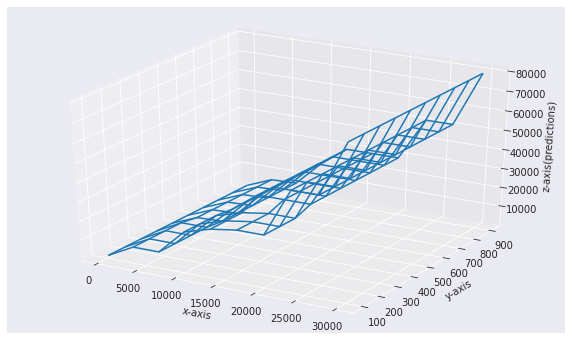

In [94]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
# to just see the prediction results of your data
#ax.scatter(X[:, 0], X[:, 1], regressor.predict(regressor.predict(X)), c='g')

samples = 10
xx, yy = np.meshgrid(np.linspace(min(X[:,0]), max(X[:,0]), samples), np.linspace(min(X[:,1]), max(X[:,1]), samples))
# to see the decision boundaries(not the right word for a decision tree regressor, I think)
ax.plot_wireframe(xx, yy, regressor.predict(np.hstack((xx.reshape(-1,1), yy.reshape(-1,1)))).reshape(xx.shape))
ax.set_xlabel('x-axis')
ax.set_ylabel('y-axis')
ax.set_zlabel('z-axis(predictions)')


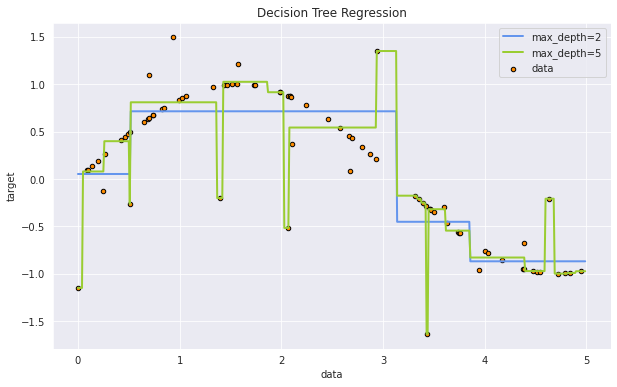

In [95]:
# Import the necessary modules and libraries
import numpy as np
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt

# Create a random dataset
rng = np.random.RandomState(1)
X = np.sort(5 * rng.rand(80, 1), axis=0)
y = np.sin(X).ravel()
y[::5] += 3 * (0.5 - rng.rand(16))

# Fit regression model
regr_1 = DecisionTreeRegressor(max_depth=2)
regr_2 = DecisionTreeRegressor(max_depth=5)
regr_1.fit(X, y)
regr_2.fit(X, y)

# Predict
X_test = np.arange(0.0, 5.0, 0.01)[:, np.newaxis]
y_1 = regr_1.predict(X_test)
y_2 = regr_2.predict(X_test)

# Plot the results
plt.figure()
plt.scatter(X, y, s=20, edgecolor="black", c="darkorange", label="data")
plt.plot(X_test, y_1, color="cornflowerblue", label="max_depth=2", linewidth=2)
plt.plot(X_test, y_2, color="yellowgreen", label="max_depth=5", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [96]:
# import export_graphviz
from sklearn.tree import export_graphviz

# export the decision tree to a tree.dot file
# for visualizing the plot easily anywhere
export_graphviz(regr_1, out_file ='/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/tree_simulation.dot',
			feature_names =['Wave'])

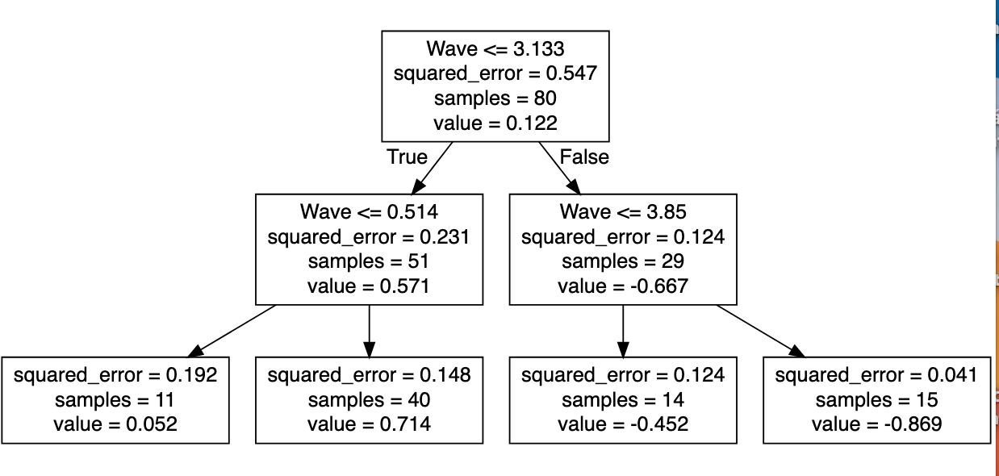

**Random Forest Regression**

Imagenes tomadas con propositos educativos de: https://www.youtube.com/watch?v=3pa0vtW64Ic


El problema de los arboles de decision es que al entrenarlos se ajustan demasiado al set de entrenamiento (bias bajo) pero al momento de hacer la prediccion la varianza es relativamente alta.

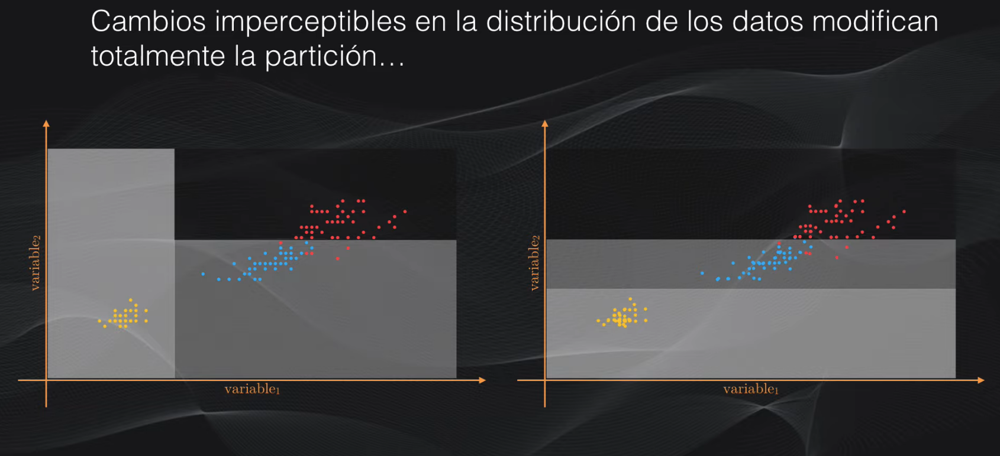

Debemos tratar de mantener el bias bajo pero al mismo tiempo disminuir su varianza. Para eso entrenaremos entre 100 y 200 arboles pero usando un subset aleatorio de los datos.
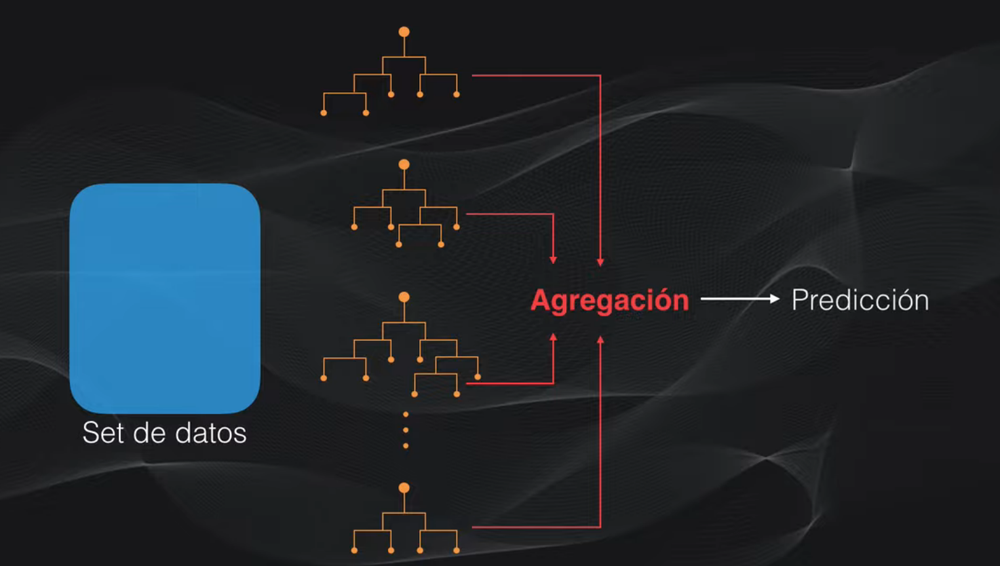

**BOOTSTRAPING**

Primero aplicamos el muestro con reemplazo:

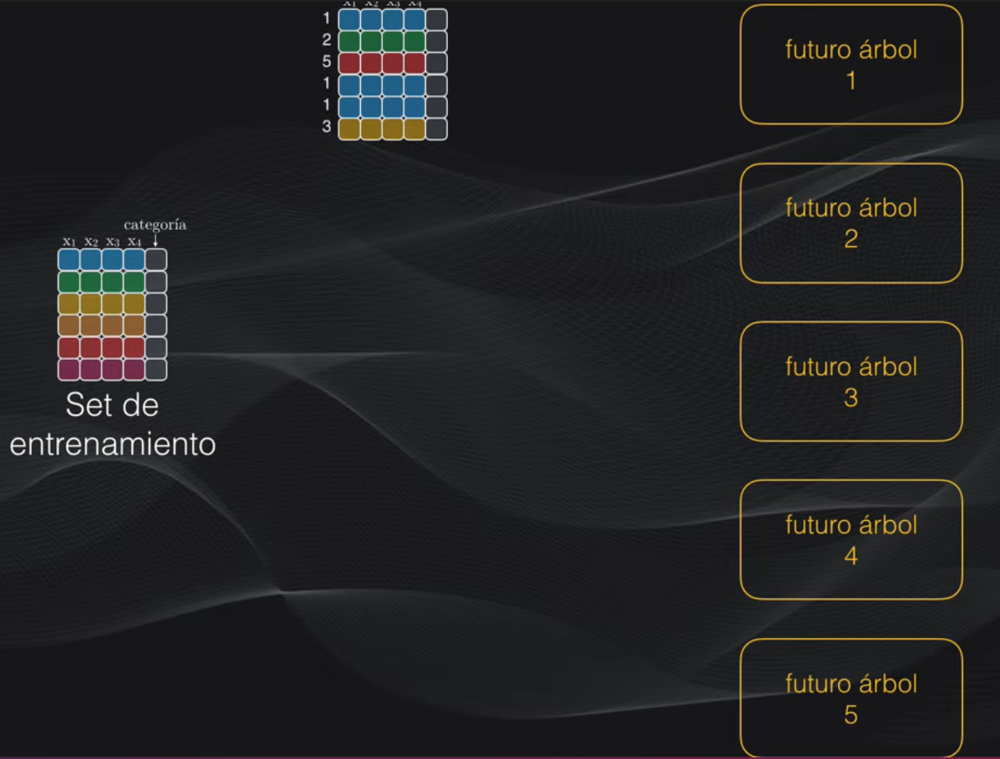

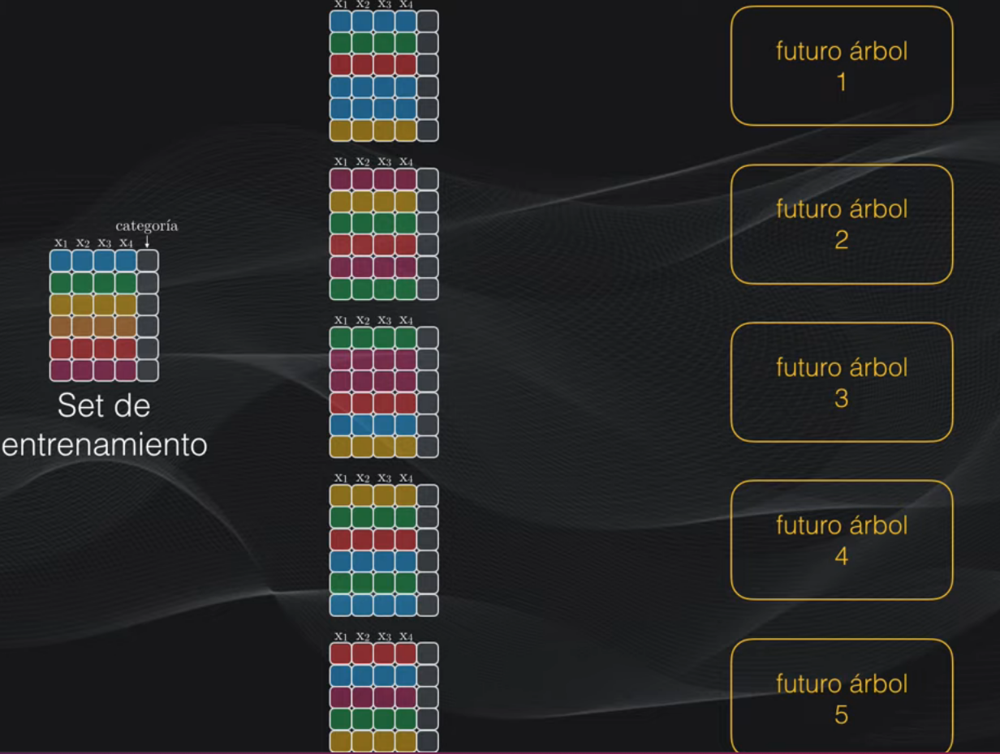

A continuacion introducimos un nuevo nivel de aleatoriedad:



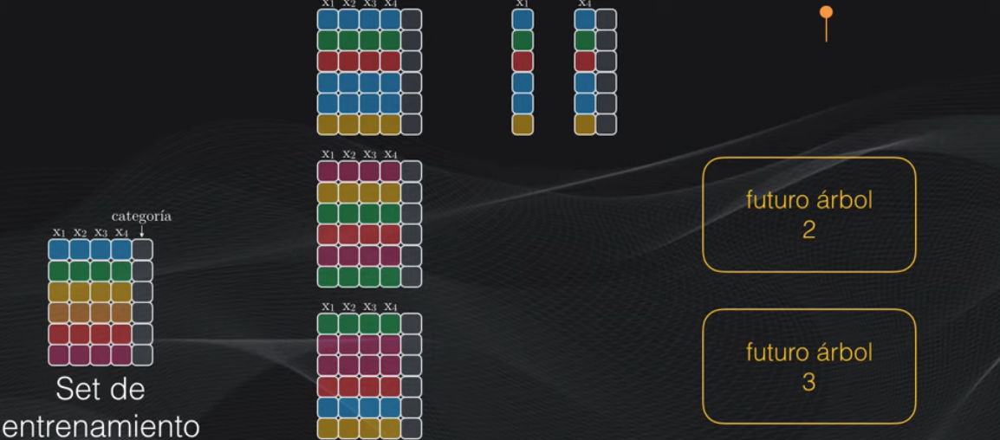

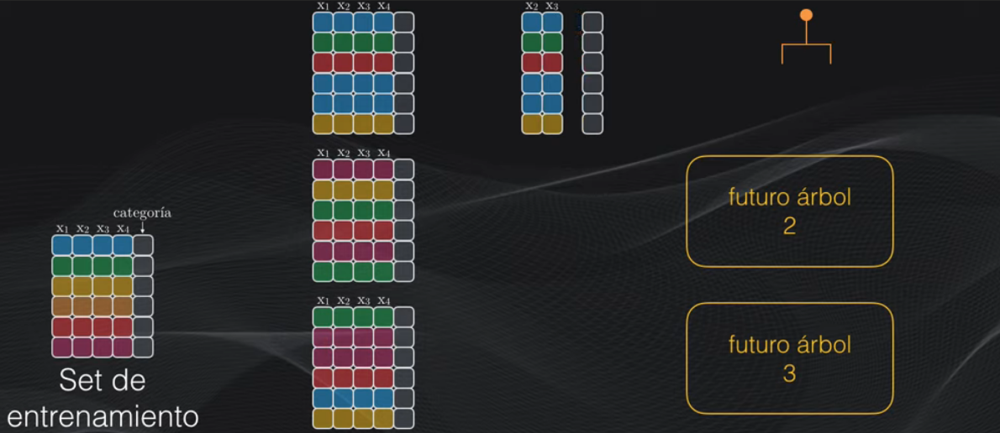

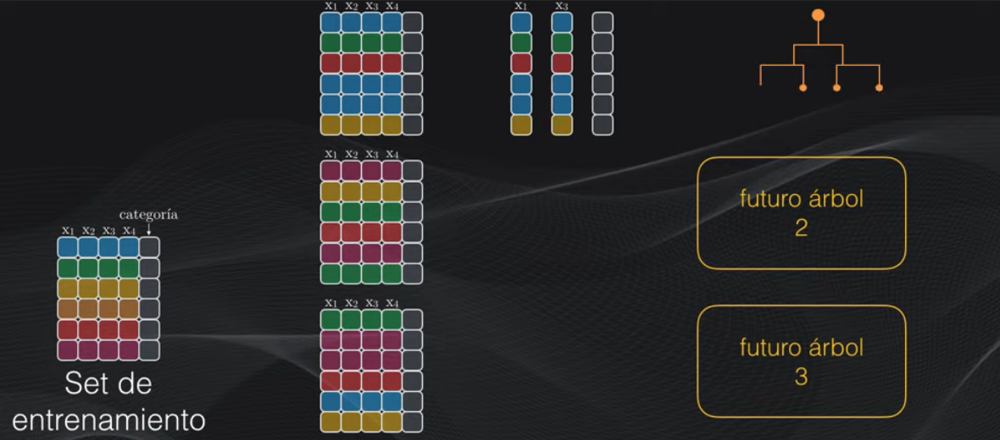

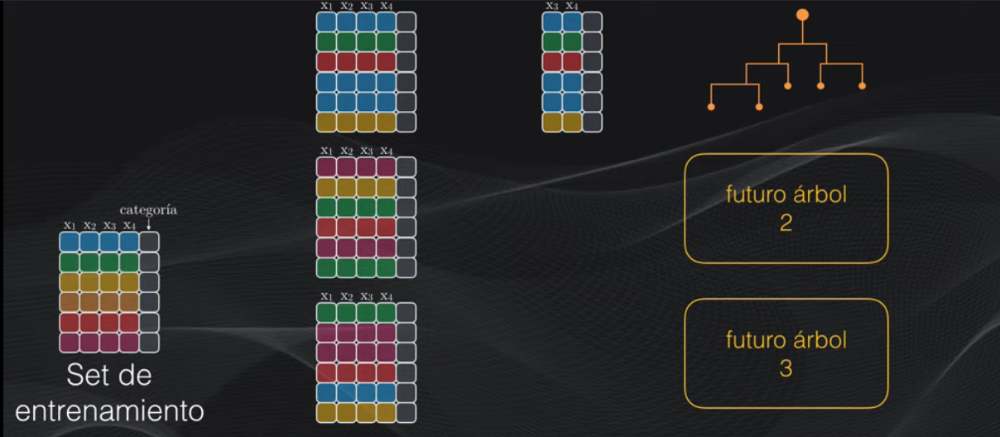

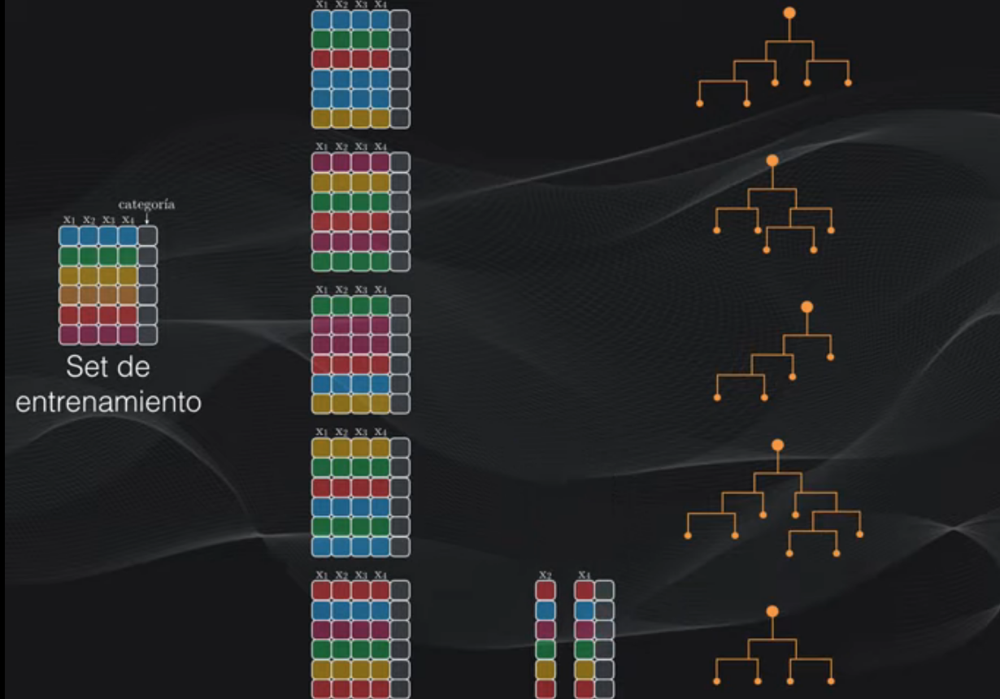

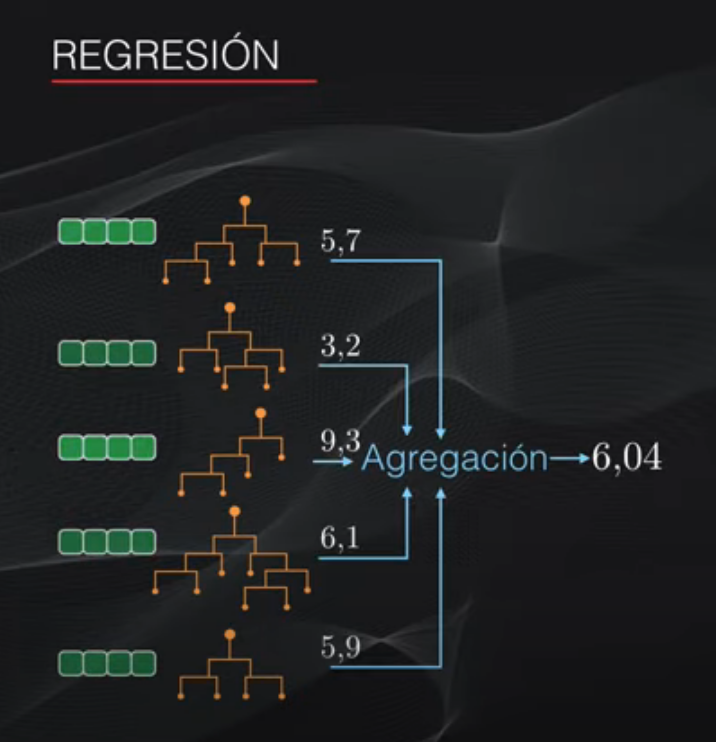

Durante el bootstraping no todas las combinaciones posibles se tomaran para el entrenamiento. Aproximadamente 1/3 de ellas no sera usada. Asi pues para los bosques aleatorios el set de validacion se extrae de las muestras que no fueron usadas durante el entrenamiento. Estos ejemplos se conocen como out-of-bag samples.

Nos quedan aun las siguientes dudas:

¿Cuantos arboles usar?

¿Hasta donde hacer crecer los arboles?

¿Cuantos features tomar durante el bootstraping?

Esto es debemos definir el valor de estos hiperparametros.

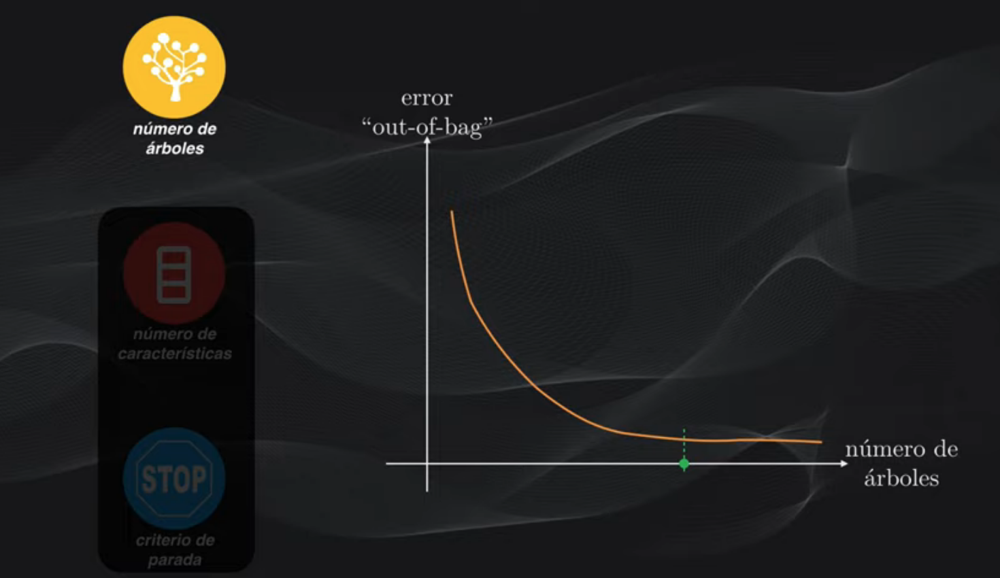



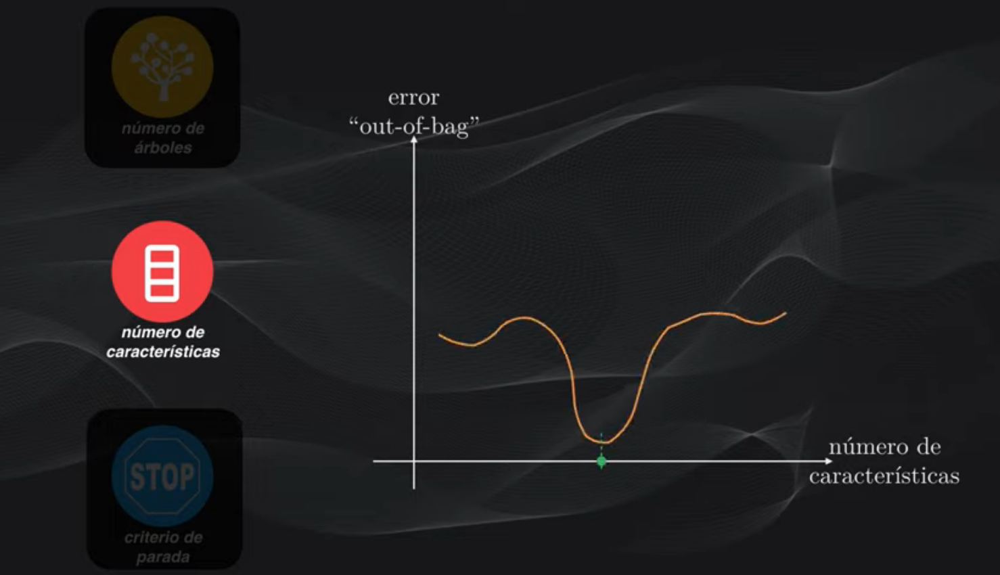

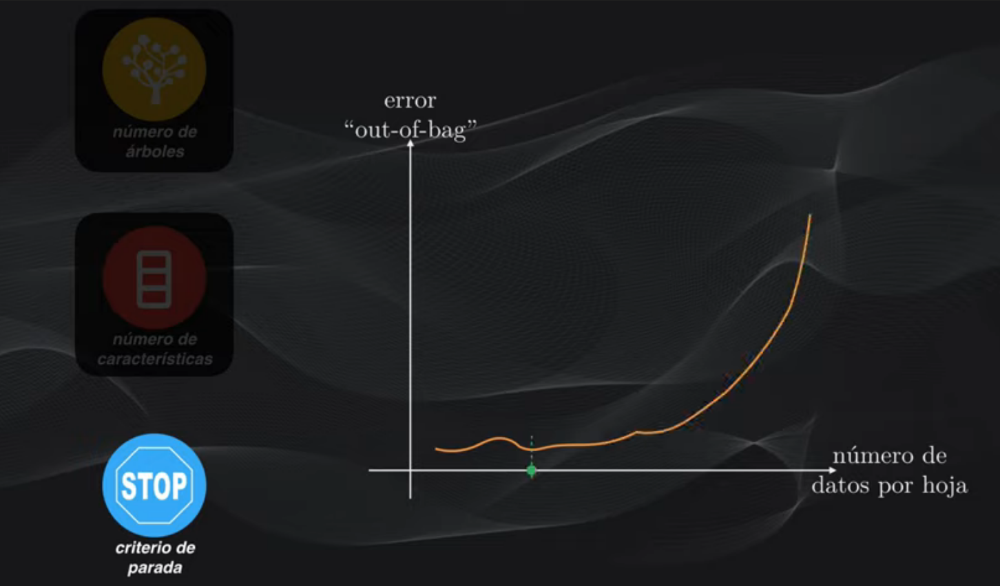

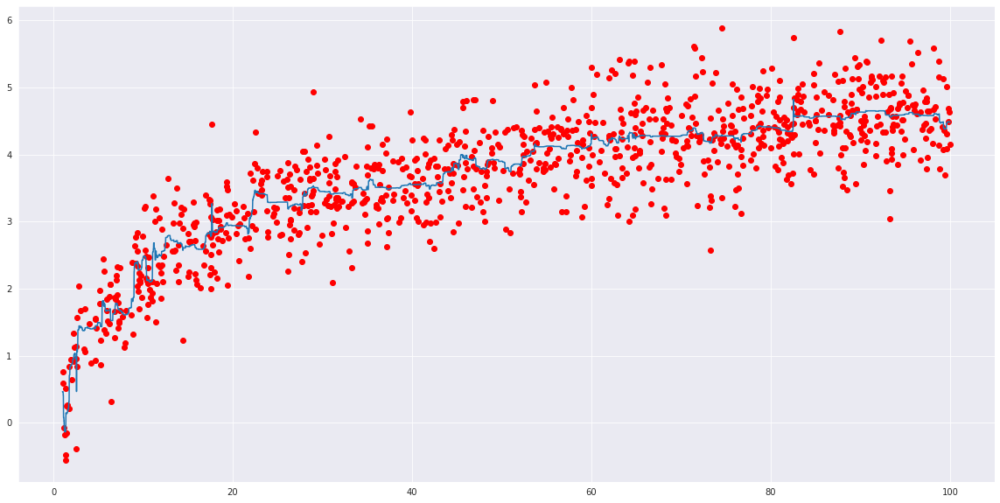

In [97]:
from sklearn.ensemble import RandomForestRegressor
import numpy as np
import matplotlib.pyplot as plt

def create_design_matrix(x_array):
    return x_array.reshape((x_array.shape[0],1))

N = 1000

x_array = np.random.uniform(1, 100, N)
y_array = np.log(x_array) + np.random.normal(0, 0.5, N)

model = RandomForestRegressor(n_estimators=100, max_depth= 5)

model = model.fit(create_design_matrix(x_array), y_array)


test_x = np.linspace(1.0, 100.0, num=10000)
test_y = model.predict(create_design_matrix(test_x))
plt.figure(figsize=(20,10)) 
plt.plot(x_array, y_array, 'ro', linewidth=5.0)
plt.plot(test_x, test_y)

plt.show()

**Random Forest Regression:**

**Temperature**

year: 2016 for all data points

month: number for month of the year

day: number for day of the year

week: day of the week as a character string

temp_2: max temperature 2 days prior

temp_1: max temperature 1 day prior

average: historical average max temperature

actual: max temperature measurement

friend: your friend’s prediction, a random number between 20 below the average and 20 above the average

In [83]:
# Pandas is used for data manipulation
import pandas as pd
# Read in data and display first 5 rows
features = pd.read_csv('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/temps.csv')
features.head(5)

,year,month,day,week,temp_2,temp_1,average,actual,forecast_noaa,forecast_acc,forecast_under,friend
0,2016,1,1,Fri,45,45,45.6,45,43,50,44,29
1,2016,1,2,Sat,44,45,45.7,44,41,50,44,61
2,2016,1,3,Sun,45,44,45.8,41,43,46,47,56
3,2016,1,4,Mon,44,41,45.9,40,44,48,46,53
4,2016,1,5,Tues,41,40,46.0,44,46,46,46,41


In [84]:
print('The shape of our features is:', features.shape)

The shape of our features is: (348, 12)


In [85]:
# Descriptive statistics for each column
features.describe()

,year,month,day,temp_2,temp_1,average,actual,forecast_noaa,forecast_acc,forecast_under,friend
count,348.0,348.000000,348.000000,348.000000,348.000000,348.000000,348.000000,348.000000,348.000000,348.000000,348.000000
mean,2016.0,6.477011,15.514368,62.652299,62.701149,59.760632,62.543103,57.238506,62.373563,59.772989,60.034483
std,0.0,3.498380,8.772982,12.165398,12.120542,10.527306,11.794146,10.605746,10.549381,10.705256,15.626179
min,2016.0,1.000000,1.000000,35.000000,35.000000,45.100000,35.000000,41.000000,46.000000,44.000000,28.000000
25%,2016.0,3.000000,8.000000,54.000000,54.000000,49.975000,54.000000,48.000000,53.000000,50.000000,47.750000
50%,2016.0,6.000000,15.000000,62.500000,62.500000,58.200000,62.500000,56.000000,61.000000,58.000000,60.000000
75%,2016.0,10.000000,23.000000,71.000000,71.000000,69.025000,71.000000,66.000000,72.000000,69.000000,71.000000
max,2016.0,12.000000,31.000000,117.000000,117.000000,77.400000,92.000000,77.000000,82.000000,79.000000,95.000000


In [86]:
# One-hot encode the data using pandas get_dummies
features = pd.get_dummies(features)
# Display the first 5 rows of the last 12 columns
features.iloc[:,5:].head(5)

,average,actual,forecast_noaa,forecast_acc,forecast_under,friend,week_Fri,week_Mon,week_Sat,week_Sun,week_Thurs,week_Tues,week_Wed
0,45.6,45,43,50,44,29,1,0,0,0,0,0,0
1,45.7,44,41,50,44,61,0,0,1,0,0,0,0
2,45.8,41,43,46,47,56,0,0,0,1,0,0,0
3,45.9,40,44,48,46,53,0,1,0,0,0,0,0
4,46.0,44,46,46,46,41,0,0,0,0,0,1,0


In [87]:
# Use numpy to convert to arrays
import numpy as np
# Labels are the values we want to predict
labels = np.array(features['actual'])
# Remove the labels from the features
# axis 1 refers to the columns
features= features.drop('actual', axis = 1)
# Saving feature names for later use
feature_list = list(features.columns)
# Convert to numpy array
features = np.array(features)

In [88]:
# Using Skicit-learn to split data into training and testing sets
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [89]:
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (261, 17)
Training Labels Shape: (261,)
Testing Features Shape: (87, 17)
Testing Labels Shape: (87,)


In [90]:
# The baseline predictions are the historical averages
baseline_preds = test_features[:, feature_list.index('average')]
# Baseline errors, and display average baseline error
baseline_errors = abs(baseline_preds - test_labels)
print('Average baseline error: ', round(np.mean(baseline_errors), 2))

Average baseline error:  5.06


In [91]:
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor
# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
# Train the model on training data
rf.fit(train_features, train_labels);

In [92]:
# Use the forest's predict method on the test data
predictions = rf.predict(test_features)
# Calculate the absolute errors
errors = abs(predictions - test_labels)
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')

Mean Absolute Error: 3.87 degrees.


In [93]:
# Calculate mean absolute percentage error (MAPE)
mape = 100 * (errors / test_labels)
# Calculate and display accuracy
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.')

Accuracy: 93.93 %.


In [94]:
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = '/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/temp_tree.dot', feature_names = feature_list, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/temp_tree.dot')
# Write graph to a png file
graph.write_png('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/temp_tree.png')

In [95]:
# Limit depth of tree to 3 levels
rf_small = RandomForestRegressor(n_estimators=10, max_depth = 3)
rf_small.fit(train_features, train_labels)
# Extract the small tree
tree_small = rf_small.estimators_[5]
# Save the tree as a png image
export_graphviz(tree_small, out_file = '/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/small_tree.dot', feature_names = feature_list, rounded = True, precision = 1)
(graph, ) = pydot.graph_from_dot_file('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/small_tree.dot')
graph.write_png('/content/drive/MyDrive/CTIC_UNI/DATA_SCIENCE/COURSE_01_MAY_2022/SESION04/small_tree.png');

In [96]:
# Get numerical feature importances
importances = list(rf.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: temp_1               Importance: 0.66
Variable: average              Importance: 0.15
Variable: forecast_noaa        Importance: 0.05
Variable: forecast_acc         Importance: 0.03
Variable: day                  Importance: 0.02
Variable: temp_2               Importance: 0.02
Variable: forecast_under       Importance: 0.02
Variable: friend               Importance: 0.02
Variable: month                Importance: 0.01
Variable: year                 Importance: 0.0
Variable: week_Fri             Importance: 0.0
Variable: week_Mon             Importance: 0.0
Variable: week_Sat             Importance: 0.0
Variable: week_Sun             Importance: 0.0
Variable: week_Thurs           Importance: 0.0
Variable: week_Tues            Importance: 0.0
Variable: week_Wed             Importance: 0.0


In [97]:
# New random forest with only the two most important variables
rf_most_important = RandomForestRegressor(n_estimators= 1000, random_state=42)
# Extract the two most important features
important_indices = [feature_list.index('temp_1'), feature_list.index('average')]
train_important = train_features[:, important_indices]
test_important = test_features[:, important_indices]
# Train the random forest
rf_most_important.fit(train_important, train_labels)
# Make predictions and determine the error
predictions = rf_most_important.predict(test_important)
errors = abs(predictions - test_labels)
# Display the performance metrics
print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')
mape = np.mean(100 * (errors / test_labels))
accuracy = 100 - mape
print('Accuracy:', round(accuracy, 2), '%.')

Mean Absolute Error: 3.92 degrees.
Accuracy: 93.76 %.


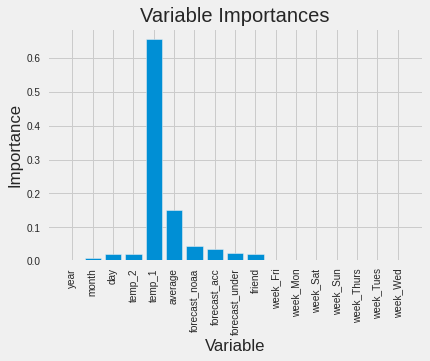

In [98]:
# Import matplotlib for plotting and use magic command for Jupyter Notebooks
import matplotlib.pyplot as plt
%matplotlib inline
# Set the style
plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(range(len(importances)))
# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical')
# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')
# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

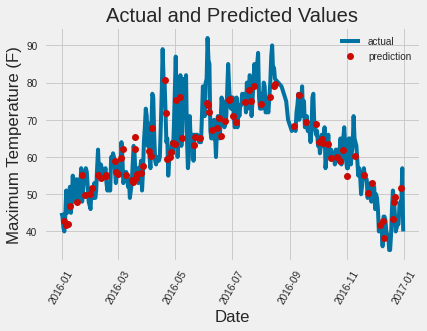

In [99]:
# Use datetime for creating date objects for plotting
import datetime
# Dates of training values
months = features[:, feature_list.index('month')]
days = features[:, feature_list.index('day')]
years = features[:, feature_list.index('year')]
# List and then convert to datetime object
dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months, days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
# Dataframe with true values and dates
true_data = pd.DataFrame(data = {'date': dates, 'actual': labels})
# Dates of predictions
months = test_features[:, feature_list.index('month')]
days = test_features[:, feature_list.index('day')]
years = test_features[:, feature_list.index('year')]
# Column of dates
test_dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months, days)]
# Convert to datetime objects
test_dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in test_dates]
# Dataframe with predictions and dates
predictions_data = pd.DataFrame(data = {'date': test_dates, 'prediction': predictions})
# Plot the actual values
plt.plot(true_data['date'], true_data['actual'], 'b-', label = 'actual')
# Plot the predicted values
plt.plot(predictions_data['date'], predictions_data['prediction'], 'ro', label = 'prediction')
plt.xticks(rotation = '60'); 
plt.legend()
# Graph labels
plt.xlabel('Date'); plt.ylabel('Maximum Temperature (F)'); plt.title('Actual and Predicted Values');

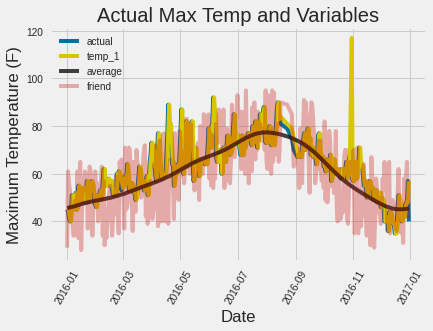

In [100]:
# Make the data accessible for plotting
true_data['temp_1'] = features[:, feature_list.index('temp_1')]
true_data['average'] = features[:, feature_list.index('average')]
true_data['friend'] = features[:, feature_list.index('friend')]
# Plot all the data as lines
plt.plot(true_data['date'], true_data['actual'], 'b-', label  = 'actual', alpha = 1.0)
plt.plot(true_data['date'], true_data['temp_1'], 'y-', label  = 'temp_1', alpha = 1.0)
plt.plot(true_data['date'], true_data['average'], 'k-', label = 'average', alpha = 0.8)
plt.plot(true_data['date'], true_data['friend'], 'r-', label = 'friend', alpha = 0.3)
# Formatting plot
plt.legend(); plt.xticks(rotation = '60');
# Lables and title
plt.xlabel('Date'); plt.ylabel('Maximum Temperature (F)'); plt.title('Actual Max Temp and Variables');